# Introduction

This is the analysis of gut intestinal stem cell data as presented in Böttcher et al. We use in total **75,012** cells from **14 samples** in **6 conditions** (2 replicates in each mutant, 3 replicates in each control and 1 sample FVR only controls):

* Control (whole crypt)
* Control (FVR enriched)
* Control (FVR only)
* Mutant (Fltp deficient, whole crypt)
* Mutant (Fltp deficient, FVR enriched)
* Control (High fat diet project)

In this notebook, data are batch corrected and normalised.

We filtered cells by

* number of reads
* number of detected genes
* fraction of mitochondrial reads (< 10%) 


## Tasks in this notebook

In order to keep the notebook structure short and well-arranged, we have split the gut intestinal stem cell analysis into several parts:

1. Pre-processing and filtering
2. Preparation of Batch effect correction
3. Batch effect correction with adjusted Combat
4. Cell type annotation (control only) 
    * ISC subtype annotation
    * Goblet, Paneth, Tuft cell subtype annotation
    * EEC subtype annotation
5. Data analysis with Graph abstraction (control only)
6. Pseudotime analysis of ISC-PC-EEC-Goblet lineage

This notebook covers **part 4** with Goblet, Paneth and Tuft subtype annotation.

# Initialise scanpy

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
import matplotlib.colors as colors
import scanpy.api as sc
import matplotlib as mpl
import anndata
#import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import scipy as sci
import os

sc.settings.verbosity = 3                # amount of output
sc.settings.set_figure_params(dpi=60, color_map='RdYlBu_r')
sc.logging.print_version_and_date()

Running Scanpy 1.3.1 on 2021-02-07 22:02.


In [2]:
import datetime

now = datetime.datetime.now()

In [3]:
today = now.strftime("%y%m%d")

Add custom color map.

In [4]:
colors2 = pl.cm.RdGy_r(np.linspace(0.4, 1, 128))
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colors2)

## Load extensions

In [5]:
%run '~/Documents/Python/maren_codes/bar_frequency.py'
%run '~/Documents/Python/maren_codes/cal_density.py'
%run '~/Documents/Python/maren_codes/genes_to_xls.py'

# Load data

Load the data set with all cells and all genes that is batch effect corrected with `ComBat` and the zero-fix. In addition, we have normalised by library size the data after batch correction. The corrected file is coupled with the full raw data (as `raw`, non-mutant cells). 

We continue to annotate the control cells, therefore, we load the control cell dataset with annotated ISC subtypes.

In [6]:
adata_ctrl= sc.read('./../data/gut_AB_AL_log_cor_control.h5ad')

# Cell type annotation and refinement

## Refine goblet cell clustering

We continue with Goblet cell clustering as we are not fully satisfied with boundary between Goblet cells and EECs.

In [7]:
a_goblet_idx = np.in1d(adata_ctrl.obs['cell_type'], 'Goblet')
a_goblet = adata_ctrl[a_goblet_idx, :]

In [8]:
sc.tl.pca(a_goblet, svd_solver='arpack')
sc.tl.tsne(a_goblet)

computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished (0:01:04.36) --> added
    'X_tsne', tSNE coordinates (adata.obsm)


In [9]:
sc.pp.neighbors(a_goblet)
sc.tl.umap(a_goblet)
sc.tl.diffmap(a_goblet)

computing neighbors
    using 'X_pca' with n_pcs = 50


/Users/Maren.Buettner/miniconda3/lib/python3.6/site-packages/sklearn/metrics/pairwise.py:257: RuntimeWarning: invalid value encountered in sqrt
  return distances if squared else np.sqrt(distances, out=distances)


    finished (0:00:07.41) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:00:15.27) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing Diffusion Maps using n_comps=15(=n_dcs)
    eigenvalues of transition matrix
    [1.         0.9852542  0.9636578  0.9567555  0.95363927 0.9457463
     0.93928087 0.9312844  0.91183937 0.90790457 0.9031564  0.9014788
     0.8930587  0.8902076  0.88431334]
    finished (0:00:00.16) --> added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns)


In [10]:
sc.tl.louvain(a_goblet, resolution=0.8)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.55) --> found 7 clusters and added
    'louvain', the cluster labels (adata.obs, categorical)


    number of colors in `.uns[louvain'_colors']` smaller than number of categories, falling back to palette


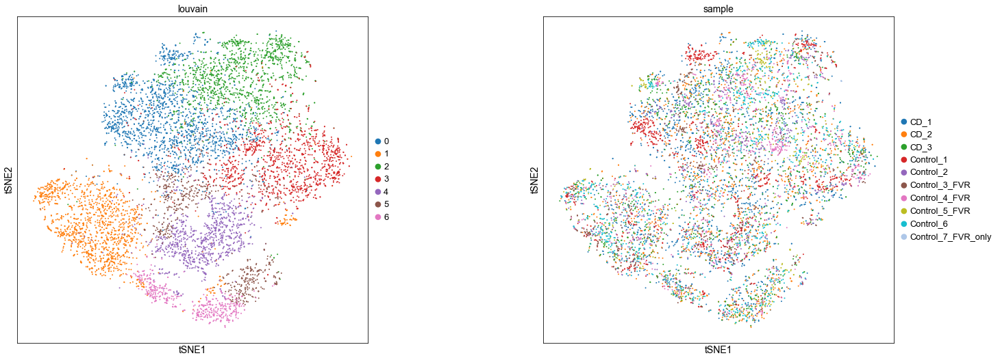

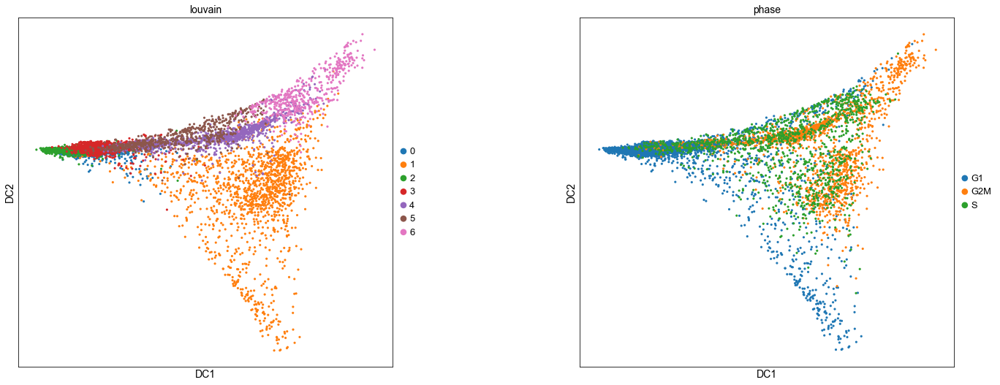

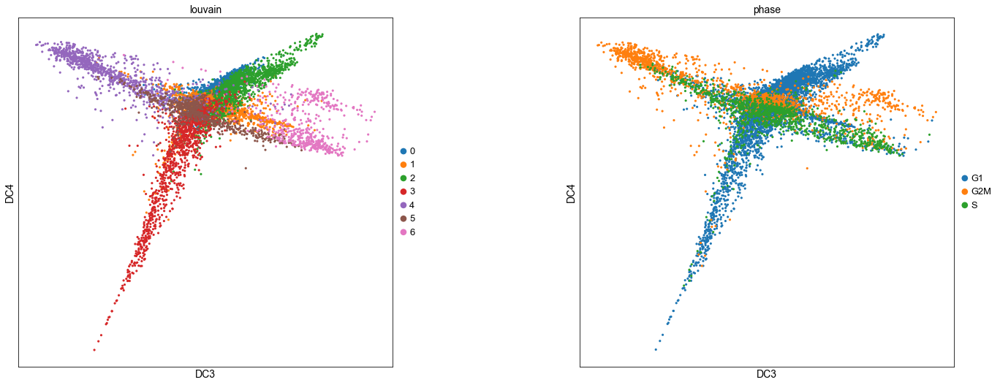

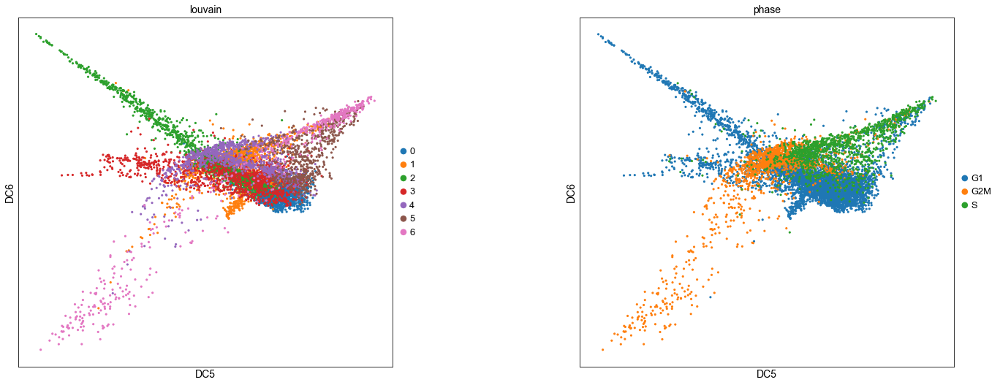

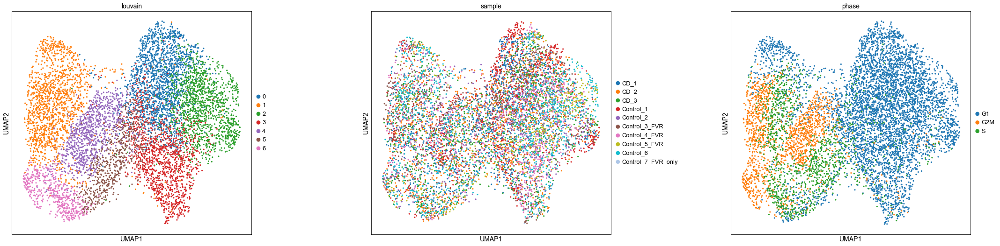

In [11]:
rcParams['figure.figsize']=(8,8)
sc.pl.tsne(a_goblet, color=['louvain', 'sample'])
sc.pl.diffmap(a_goblet, color=['louvain','phase'], size=40, components=['1,2', '3,4', '5,6'])
#sc.pl.draw_graph(a_goblet, color=['louvain', 'phase'])
sc.pl.umap(a_goblet, color=['louvain', 'sample', 'phase'], size=40)

### Visualise marker genes

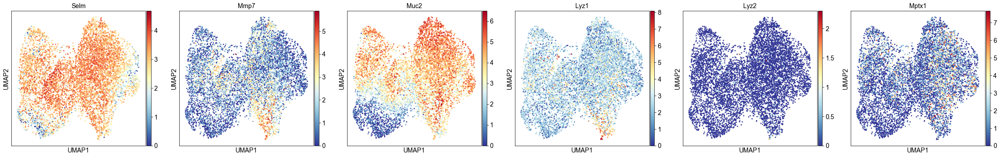

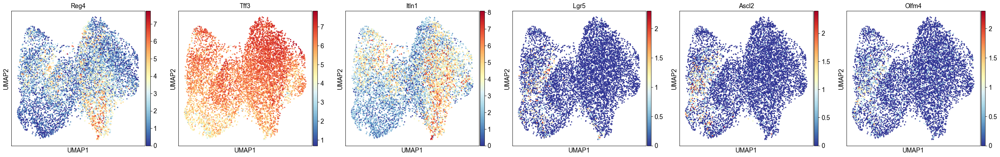

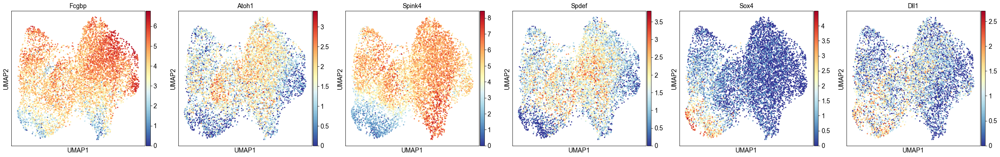

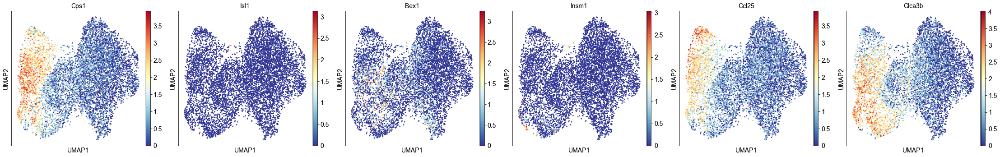

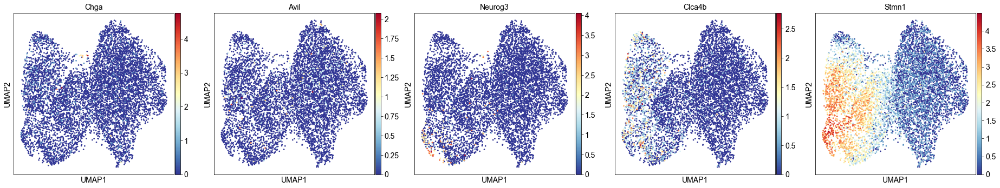

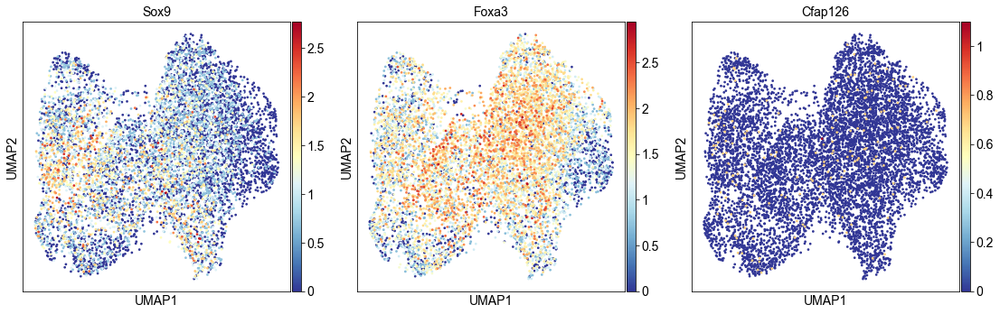

In [12]:
rcParams['figure.figsize']=(5,5)
sc.pl.umap(a_goblet, color=['Selm', 'Mmp7','Muc2', 'Lyz1', 'Lyz2', 'Mptx1'], size=30)
sc.pl.umap(a_goblet, color=['Reg4', 'Tff3', 'Itln1', 'Lgr5', 'Ascl2', 'Olfm4'], size=30)
sc.pl.umap(a_goblet, color=['Fcgbp','Atoh1','Spink4','Spdef', 'Sox4', 'Dll1'], size=30)
sc.pl.umap(a_goblet, color=[ 'Cps1', 'Isl1', 'Bex1', 'Insm1', 'Ccl25', 'Clca3b'], size=30)
sc.pl.umap(a_goblet, color=[ 'Chga', 'Avil', 'Neurog3', 'Clca4b', 'Stmn1'], size=30)
sc.pl.umap(a_goblet, color=['Sox9', 'Foxa3', 'Cfap126'], size=30)

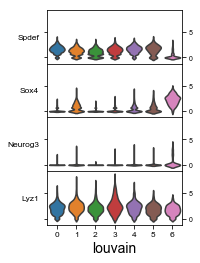

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a1d68a6a0>,
      dtype=object)

In [13]:
sc.pl.stacked_violin(a_goblet,groupby='louvain', var_names=['Spdef', 'Sox4','Neurog3', 'Lyz1'], swap_axes=True)

Cluster 6 expresses Sox4, a classical progenitor marker, and lower levels of Spdef, a classical Goblet cell marker. Further, we observe light expression of Neurog3, an EEC marker.

Next, we explore the Goblet cell heterogeneity further.

### Resolve cluster 1

In [14]:
sc.tl.louvain(a_goblet, resolution=1.5, restrict_to=['louvain',['1']])

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.07) --> found 10 clusters and added
    'louvain_R', the cluster labels (adata.obs, categorical)


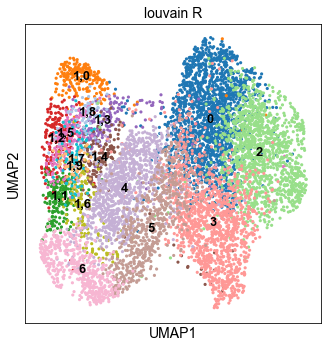

In [15]:
rcParams['figure.figsize']=(5,5)
sc.pl.umap(a_goblet, color='louvain_R', size=40, legend_loc='on data')

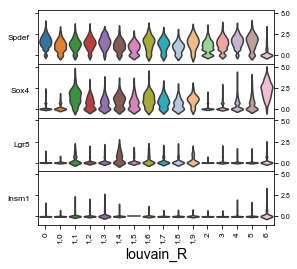

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a2a4cf9e8>,
      dtype=object)

In [16]:
rcParams['figure.figsize']=(10,5)
sc.pl.stacked_violin(a_goblet, groupby='louvain_R',swap_axes=True,
                     var_names=['Spdef', 'Sox4','Lgr5', 'Insm1'])

### Resolve cluster 4-5 (Goblet progenitors)

In [17]:
sc.tl.louvain(a_goblet, resolution=2, restrict_to=['louvain_R',['4','5']])

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.07) --> found 15 clusters and added
    'louvain_R_R', the cluster labels (adata.obs, categorical)


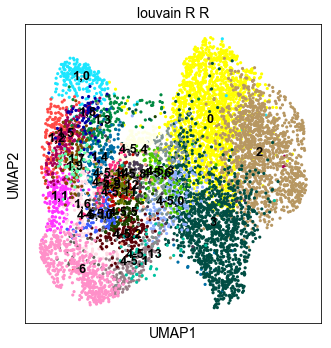

In [18]:
rcParams['figure.figsize']=(5,5)
sc.pl.umap(a_goblet, color='louvain_R_R', size=40, legend_loc='on data')

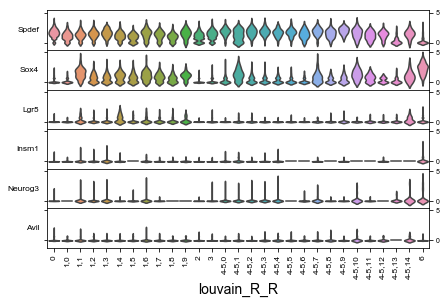

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a1e41b7b8>,
      dtype=object)

In [19]:
sc.pl.stacked_violin(a_goblet, groupby='louvain_R_R',
                     swap_axes=True, 
                     var_names=['Spdef', 'Sox4','Lgr5', 'Insm1', 'Neurog3','Avil'])

From *Spdef* and *Sox4* expression, we conclude that clusters **4-5,13**, **4-5,14** and **6** can be counted as *Sox4* positive progenitors.  

### Resolve cluster 6

In [20]:
sc.tl.louvain(a_goblet, resolution=1.5, restrict_to=['louvain_R_R',['6']])

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.02) --> found 8 clusters and added
    'louvain_R_R_R', the cluster labels (adata.obs, categorical)


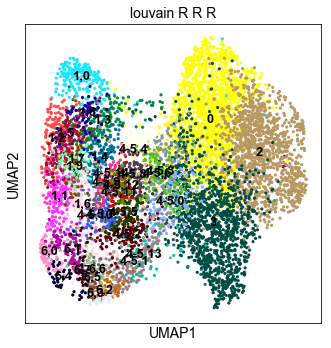

In [21]:
rcParams['figure.figsize']=(5,5)
sc.pl.umap(a_goblet, color='louvain_R_R_R', size=40, legend_loc='on data')

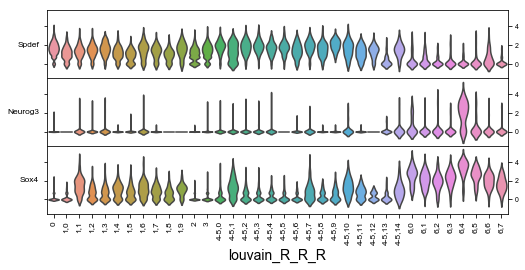

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a2ebb5d68>,
      dtype=object)

In [39]:
rcParams['figure.figsize']=(10,5)
sc.pl.stacked_violin(a_goblet, groupby='louvain_R_R_R', var_names=['Spdef', 'Neurog3','Sox4'], swap_axes=True)

Upon resolving cluster 6, we can identify a `Sox4` and `Neurog3` high population, which we will count as `EECs`.

### Resolve cluster 3 (Lyz1 positive cells)

In [22]:
sc.tl.louvain(a_goblet, resolution=1.5, restrict_to=['louvain_R_R_R',['3']])

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.06) --> found 12 clusters and added
    'louvain_R_R_R_R', the cluster labels (adata.obs, categorical)


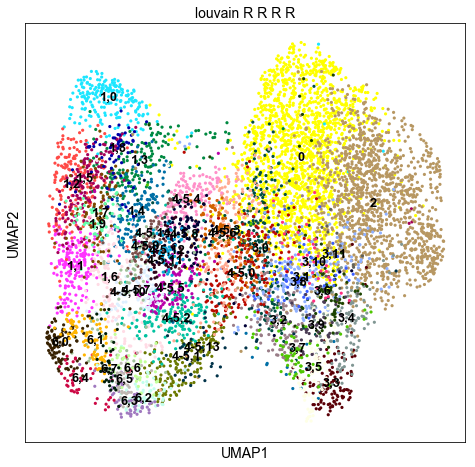

In [23]:
rcParams['figure.figsize']=(7,7)
sc.pl.umap(a_goblet, color='louvain_R_R_R_R', size=40, legend_loc='on data')

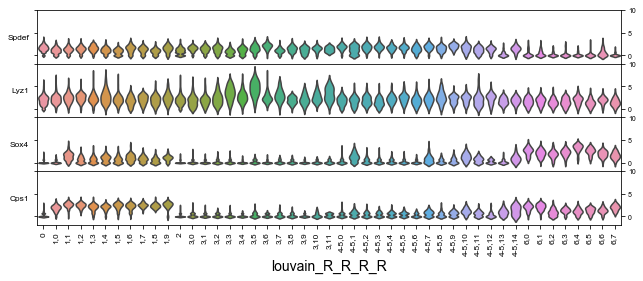

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a2ee8df98>,
      dtype=object)

In [35]:
rcParams['figure.figsize']=(10,5)
sc.pl.stacked_violin(a_goblet, groupby='louvain_R_R_R_R', var_names=['Spdef', 'Lyz1','Sox4', 'Cps1'], swap_axes=True)

As remark, we find some *Lyz1* expression in mature Goblet cells (here, clusters **3,3**, **3,5**). We will consider those subclusters as 'Lyz1 high Goblet' cells, but keep them in the major group of Goblet cells. It must be noted, that the ambient level of *Lyz1* is rather high for all cells.

### Create gene ranking

In [25]:
sc.tl.rank_genes_groups(a_goblet, groupby='louvain_R_R_R_R')

ranking genes
    finished (0:00:45.44) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids


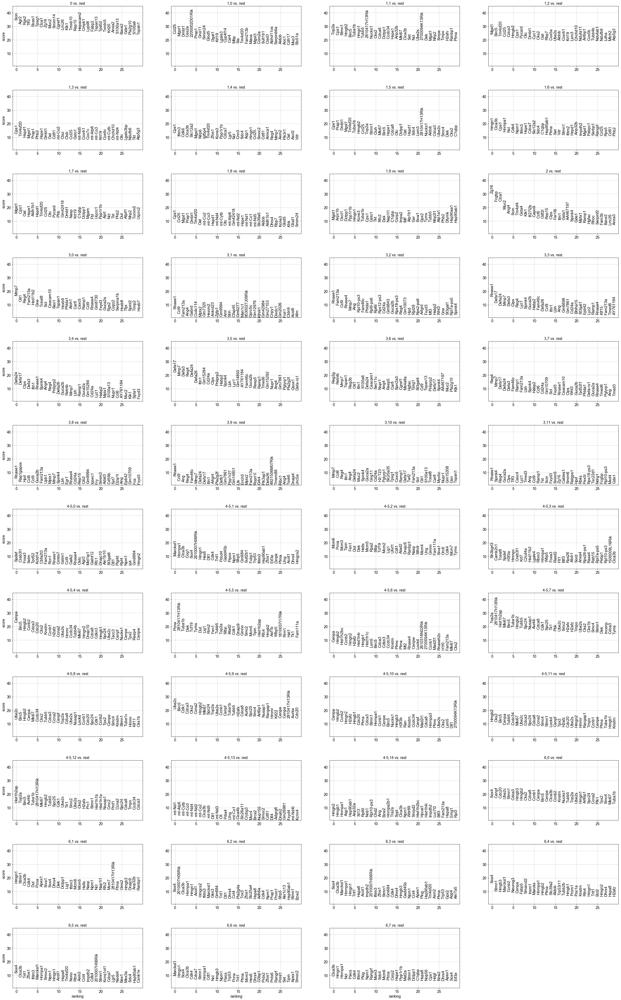

In [26]:
sc.pl.rank_genes_groups(a_goblet, fontsize=15, n_genes=30)

In [27]:
genes_to_xls(adata=a_goblet, filename='./../table/goblet_refined_new.xls')

Collect the top 10 differential genes per cluster and paste them into a single variable (without duplicates). 

In [28]:
df = np.array([])
for i in a_goblet.uns['rank_genes_groups']['names'].dtype.names:
    d = a_goblet.uns['rank_genes_groups']['names'][i][:10]
    df = np.concatenate([df,d])

In [29]:
genes_goblet = pd.value_counts(df).index

In [30]:
genes_goblet

Index(['Hmgb2', 'Hmgn1', 'Clca3b', 'Cps1', 'Mmp7', 'Reg4', 'Birc5', 'Mgst1',
       'Hnrnpa1', 'Rnase1',
       ...
       'Ceacam1', 'Gng11', 'Lig1', 'Insm1', 'Camk2n1', 'Smarcd2', 'Rgs2',
       'Gabrd', 'Phlda1', 'Ifi27l2b'],
      dtype='object', length=211)

In [31]:
genes_goblet_idx = np.flatnonzero(np.in1d(a_goblet.var_names, genes_goblet))


### Create graph

Set a root cell for pseudotime analysis.

In [32]:
np.flatnonzero(np.in1d(a_goblet.obs['louvain_R_R_R'], '6,6'))[:15]

array([ 190,  501,  533, 1421, 1438, 1570, 1585, 1714, 2088, 2112, 2243,
       2279, 2563, 2673, 2871])

In [33]:
a_goblet.uns['iroot'] = 190
sc.pp.neighbors(a_goblet)
sc.tl.paga(a_goblet, groups='louvain_R_R_R_R')
sc.tl.dpt(a_goblet)

computing neighbors
    using 'X_pca' with n_pcs = 50


/Users/Maren.Buettner/miniconda3/lib/python3.6/site-packages/sklearn/metrics/pairwise.py:257: RuntimeWarning: invalid value encountered in sqrt
  return distances if squared else np.sqrt(distances, out=distances)


    finished (0:00:03.81) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
running partition-based graph abstraction (PAGA)
    finished (0:00:01.56) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00.00) --> added
    'dpt_pseudotime', the pseudotime (adata.obs)


--> added 'pos', the PAGA positions (adata.uns['paga'])


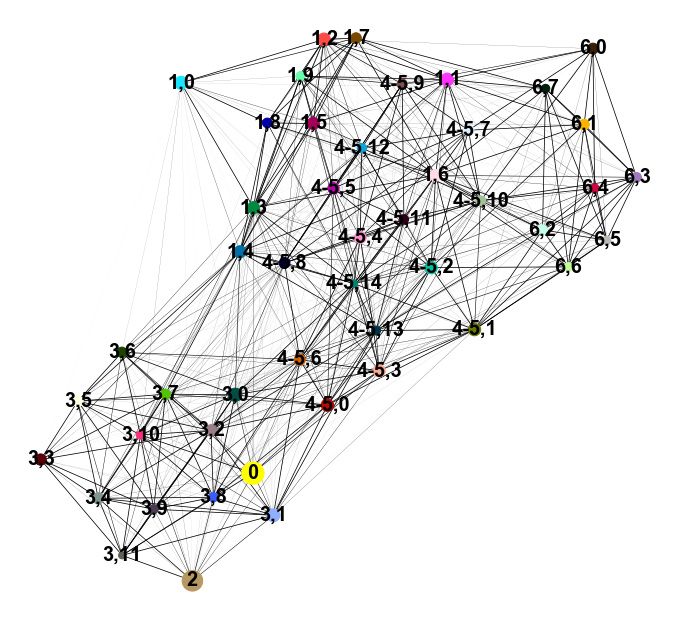

In [34]:
rcParams['figure.figsize']=(10,10)
sc.pl.paga(a_goblet, fontsize=20, frameon=False, edge_width_scale=0.1)

### Visualise differentially expressed genes

Sort the differentially expressed genes by hierarchical clustering, *i.e.* by similar expression patterns. 

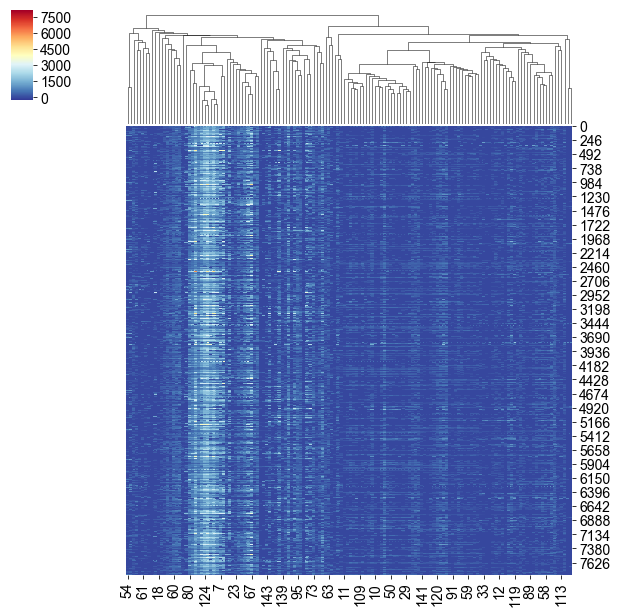

In [36]:
g=sns.clustermap(a_goblet.X[:,genes_goblet_idx].todense(),cmap="RdYlBu_r",
                 row_cluster=False,metric='correlation')

In [37]:
gene_names_diff=a_goblet[:,genes_goblet_idx].var_names[g.dendrogram_col.reordered_ind]

Plot cells grouped by cluster.

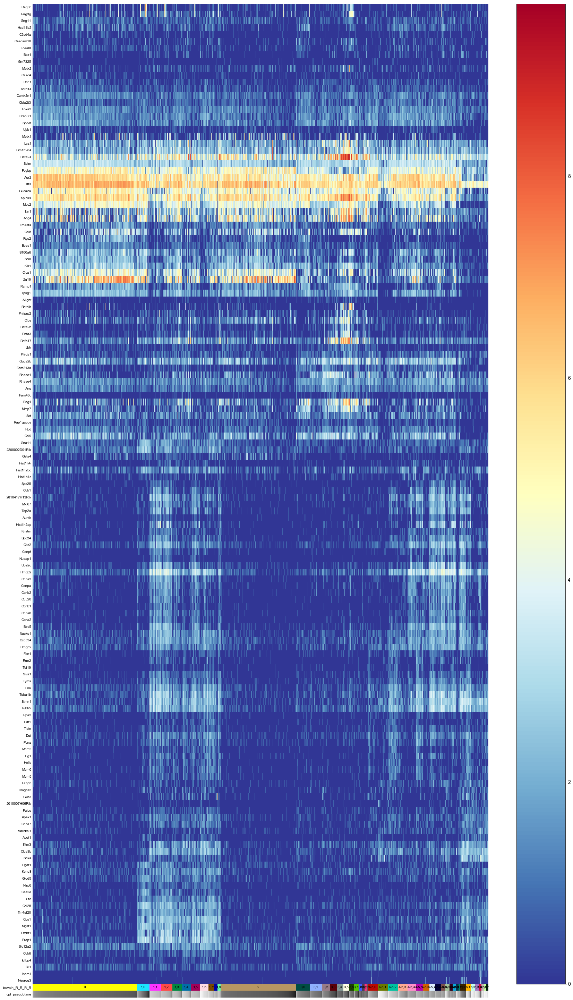

In [38]:
rcParams['figure.figsize']=(30,50)
sc.pl.paga_path(a_goblet, keys=gene_names_diff, 
                nodes=a_goblet.obs['louvain_R_R_R_R'].cat.categories,
                #['7,0', '7,1', '7,2', '7,3', '7,4', '7,5', '7,6',
      # '7,7'],
                
                color_map="RdYlBu_r")


### Merge some groups

We found a group of cells with EEC progenitor profile (`Neurog3` and `Insm1` positive) and some `Lyz1` positive cells. Apart from these tiny populations, we identify early and mature Goblet cells, Goblet progenitors and `Sox4` high populations. 

The fine-grained clustering, differential expression analysis and heatmap inspection brings us to the following results:
 
* cluster `3,3`, `3,5`: `Lyz1` high Goblet
* clusters `6,0`- `6,3`, `6,5`-`6,7`: `Sox4` pos EE progenitor
* cluster `6,4` : EE progenitor (counted to EECs)
* clusters `1,0` -`1,9`, `4-5,9`: Goblet progenitor 
* clusters  `4-5,0`- `4-5,8`, `4-5,10`- `4-5,14`: early Goblet 
* clusters `3,0`, `3,1`, `3,2` ,`3,4`, `3,6`-`3,11`, `0`, `2` : mature Goblet cell

In [40]:
a_goblet.obs['louvain_R_R_R_R'].cat.categories

Index(['0', '1,0', '1,1', '1,2', '1,3', '1,4', '1,5', '1,6', '1,7', '1,8',
       '1,9', '2', '3,0', '3,1', '3,2', '3,3', '3,4', '3,5', '3,6', '3,7',
       '3,8', '3,9', '3,10', '3,11', '4-5,0', '4-5,1', '4-5,2', '4-5,3',
       '4-5,4', '4-5,5', '4-5,6', '4-5,7', '4-5,8', '4-5,9', '4-5,10',
       '4-5,11', '4-5,12', '4-5,13', '4-5,14', '6,0', '6,1', '6,2', '6,3',
       '6,4', '6,5', '6,6', '6,7'],
      dtype='object')

In [60]:
a_goblet.obs['Goblet_group_final']= a_goblet.obs['louvain_R_R_R_R']
a_goblet.obs['Goblet_group_final']= a_goblet.obs['Goblet_group_final'].cat.add_categories(
    ['mature Goblet', 'Goblet progenitor', 'Lyz1 high Goblet', 'early Goblet',
     'Sox4+ early EE progenitor', 'EE progenitor'])

a_goblet.obs['Goblet_group_final'][np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                    ['1,0', '1,1', '1,2', '1,3', '1,4', '1,5', '1,6', '1,7', '1,8',
       '1,9', '4-5,9'])] = np.repeat(
    'Goblet progenitor', np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                    ['1,0', '1,1', '1,2', '1,3', '1,4', '1,5', '1,6', '1,7', '1,8',
       '1,9', '4-5,9']).sum())
a_goblet.obs['Goblet_group_final'][np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                                ['4-5,0', '4-5,1', '4-5,2', '4-5,3',
       '4-5,4', '4-5,5', '4-5,6', '4-5,7', '4-5,8',  '4-5,10',
       '4-5,11','4-5,12', '4-5,13', '4-5,14'])] = np.repeat(
    'early Goblet', np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                          ['4-5,0', '4-5,1', '4-5,2', '4-5,3',
       '4-5,4', '4-5,5', '4-5,6', '4-5,7', '4-5,8',  '4-5,10',
       '4-5,11','4-5,12', '4-5,13', '4-5,14']).sum())
a_goblet.obs['Goblet_group_final'][np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                        ['6,0', '6,1', '6,2', '6,3',
        '6,5', '6,6', '6,7'])] = np.repeat(
    'Sox4+ early EE progenitor', np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                           ['6,0', '6,1', '6,2', '6,3',
        '6,5', '6,6', '6,7']).sum())
a_goblet.obs['Goblet_group_final'][np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                                     ['3,3', '3,5'])] = np.repeat(
    'Lyz1 high Goblet', np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                                ['3,3', '3,5']).sum())
a_goblet.obs['Goblet_group_final'][np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                                     ['0', '2', '3,0', '3,1', '3,2' ,'3,4', 
                                      '3,6', '3,7','3,8','3,9','3,10','3,11', 
                                     ])] = np.repeat(
    'mature Goblet', np.in1d(a_goblet.obs['louvain_R_R_R_R'],
                             ['0', '2', '3,0', '3,1', '3,2' ,'3,4', 
                                      '3,6', '3,7','3,8','3,9','3,10','3,11']).sum())
a_goblet.obs['Goblet_group_final'][np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                                     [ '6,4'])] = np.repeat(
    'EE progenitor', np.in1d(a_goblet.obs['louvain_R_R_R_R'], 
                            [ '6,4']).sum())


a_goblet.obs['Goblet_group_final']=a_goblet.obs['Goblet_group_final'].cat.remove_unused_categories()

In [61]:
a_goblet.obs['Goblet_group_final'].cat.categories

Index(['mature Goblet', 'Goblet progenitor', 'Lyz1 high Goblet',
       'early Goblet', 'Sox4+ early EE progenitor', 'EE progenitor'],
      dtype='object')

In [62]:
a_goblet.obs['Goblet_group_major']= a_goblet.obs['Goblet_group_final'].cat.add_categories(
    ['Goblet cell', 'EEC'])

a_goblet.obs['Goblet_group_major'][np.in1d(a_goblet.obs['Goblet_group_final'], 
                                           ['mature Goblet', 'Lyz1 high Goblet'])] = np.repeat(
    'Goblet cell', np.in1d(a_goblet.obs['Goblet_group_final'], 
                           ['mature Goblet', 'Lyz1 high Goblet']).sum())
a_goblet.obs['Goblet_group_major'][np.in1d(a_goblet.obs['Goblet_group_final'], 
                                     ['EE progenitor'])] = np.repeat(
    'EEC', np.in1d(a_goblet.obs['Goblet_group_final'], 
                            ['EE progenitor']).sum())


a_goblet.obs['Goblet_group_major']=a_goblet.obs['Goblet_group_major'].cat.remove_unused_categories()

In [63]:
a_goblet.obs['Goblet_group_major'].cat.categories

Index(['Goblet progenitor', 'early Goblet', 'Sox4+ early EE progenitor',
       'Goblet cell', 'EEC'],
      dtype='object')

Create a new (more coarse-grained) graph.

In [64]:
sc.tl.paga(a_goblet, groups='Goblet_group_final')

running partition-based graph abstraction (PAGA)
    finished (0:00:00.32) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)


--> added 'pos', the PAGA positions (adata.uns['paga'])


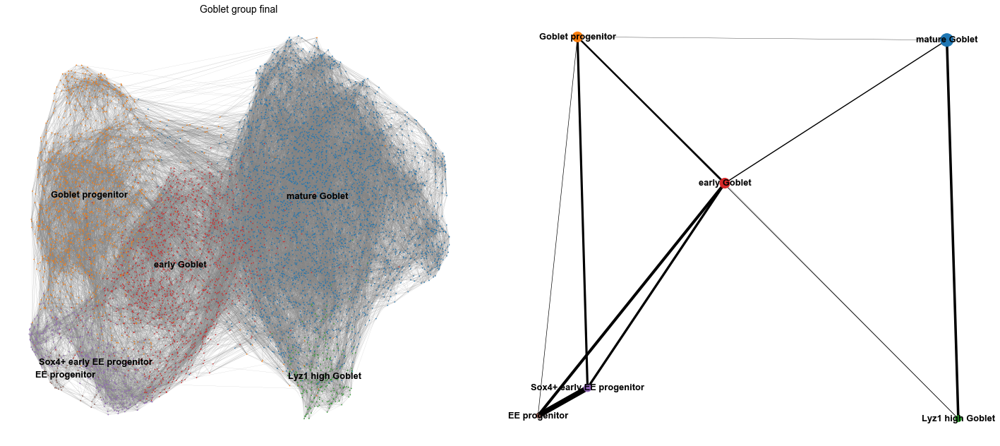

In [65]:
rcParams['figure.figsize']=(10,10)
sc.pl.paga_compare(a_goblet, basis='umap', frameon=False, edges=True, size=10)

Recompute gene ranking for the more coarse-grained clustering.

In [66]:
sc.tl.rank_genes_groups(a_goblet, groupby='Goblet_group_final')

ranking genes
    finished (0:00:05.87) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids


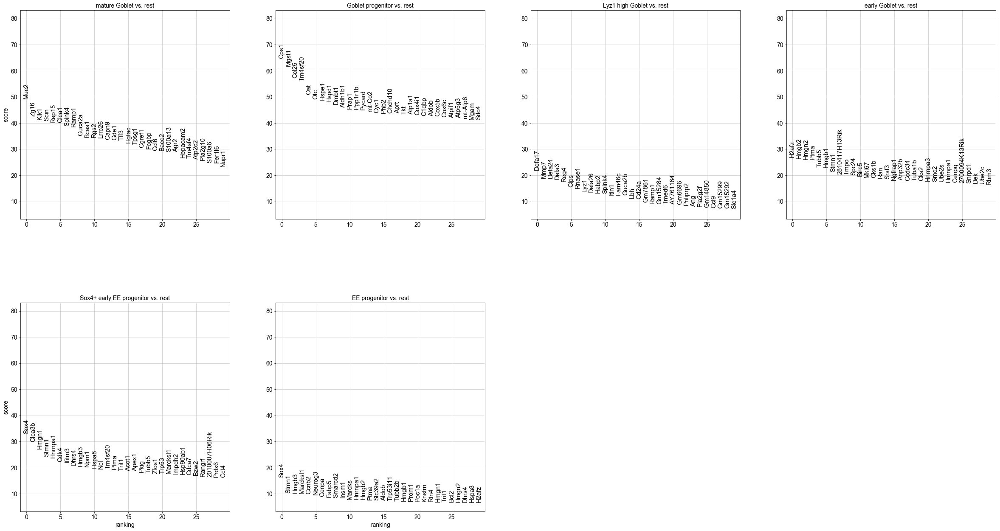

In [67]:
sc.pl.rank_genes_groups(a_goblet, fontsize=15, n_genes=30)

Collect the top 15 differential genes per cluster and paste them into a single variable (without duplicates). 

In [68]:
df = np.array([])
for i in a_goblet.uns['rank_genes_groups']['names'].dtype.names:
    d = a_goblet.uns['rank_genes_groups']['names'][i][:15]
    df = np.concatenate([df,d])

In [69]:
genes_goblet = pd.value_counts(df).index

In [70]:
genes_goblet

Index(['Ptma', 'Stmn1', 'Hnrnpa1', 'Tm4sf20', 'Sox4', 'Hmgb2', 'Spink4',
       'Hmgb3', 'Ppp1r1b', 'Cdk4', 'Itln1', 'Clca3b', 'Srsf3', 'Rep15', 'Tmpo',
       'Defa26', '2810417H13Rik', 'Ccl25', 'Spc24', 'Ramp1', 'Oat', 'H2afz',
       'mt-Co2', 'Defa3', 'Fam46c', 'Tff3', 'Hmgb1', 'Guca2b', 'Pycard',
       'Cyc1', 'Cenpa', 'Dmbt1', 'Npm1', 'Muc2', 'Hspe1', 'Lbh', 'Prap1',
       'Zg16', 'Klk1', 'Hspa8', 'Tubb5', 'Ccnb2', 'Defa24', 'Bcas1', 'Slc39a2',
       'Mki67', 'Mgst1', 'Gde1', 'Lrrc26', 'Smarcd2', 'Birc5', 'Ran', 'Ncl',
       'Otc', 'Rgs2', 'Lyz1', 'Hmgn1', 'Mmp7', 'Hmgn2', 'Trit1', 'Dhrs4',
       'Cps1', 'Clca1', 'Hspd1', 'Capn9', 'Reg4', 'Scin', 'Ifitm3', 'Fabp5',
       'Insm1', 'Aldh1b1', 'Rnase1', 'Clps', 'Marcksl1', 'Habp2', 'Marcks',
       'Guca2a', 'Neurog3', 'Defa17', 'Cks1b'],
      dtype='object')

In [71]:
genes_goblet_idx = np.flatnonzero(np.in1d(a_goblet.var_names, genes_goblet))


Sort the differentially expressed genes by hierarchical clustering, *i.e.* by similar expression patterns. 

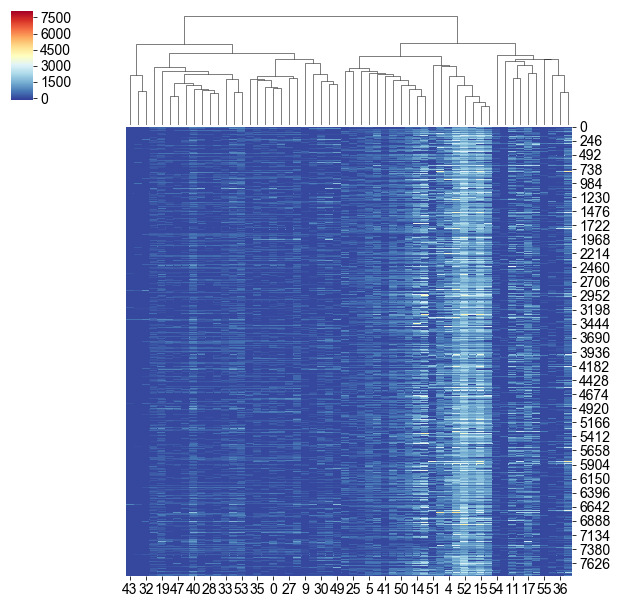

In [72]:
g=sns.clustermap(a_goblet.X[:,genes_goblet_idx].todense(),cmap="RdYlBu_r",row_cluster=False,metric='correlation')

In [73]:
gene_names_diff=a_goblet[:,genes_goblet_idx].var_names[g.dendrogram_col.reordered_ind]

Plot the final clustering.

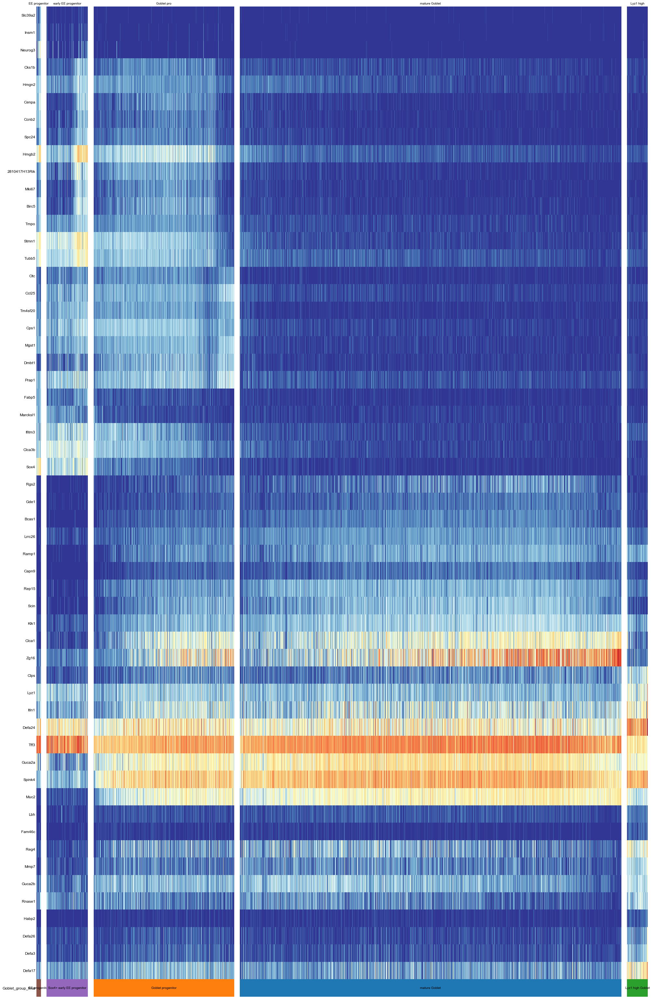

In [74]:
paths = [('EE progenitor',['EE progenitor']), 
        ('early EE progenitor',['Sox4+ early EE progenitor']),
        ('Goblet pro',['Goblet progenitor']),  
        ('mature Goblet', ['mature Goblet']), 
        ('Lyz1 high',['Lyz1 high Goblet'])
        
]

path_ratios= pd.value_counts(a_goblet.obs['Goblet_group_final']).values
path_cat = pd.value_counts(a_goblet.obs['Goblet_group_final']).index
tmp=np.zeros(len(paths))
for ipath, (descr, path) in enumerate(paths):
    #print(path[1])
    idx = np.flatnonzero(np.in1d(path_cat, path))
    #print(idx)
    tmp[ipath] = path_ratios[idx]
    
tmp = tmp.astype('int')
path_ratios = tmp / tmp.sum() *len(path_ratios)

_, axs = pl.subplots(ncols=len(tmp), figsize=(30, 55), 
                     gridspec_kw={'wspace': 0.05, 'left': 0.11,'width_ratios':path_ratios})
pl.subplots_adjust(left=0.05, right=0.98, top=0.88)
for ipath, (descr, path) in enumerate(paths):
    sc.pl.paga_path(a_goblet, left_margin=0.3, ytick_fontsize=12, color_map='RdYlBu_r',
                   nodes=path, ax=axs[ipath],
                   keys=np.concatenate([gene_names_diff]),
                   annotations=[],
                   show_yticks=True if ipath==0 else False,
                   show_colorbar=False,                        
                   n_avg=2,
                   title='{}'.format(descr),
                   show=False)
#pl.savefig('./figures/aga_EEC.png', dpi=300)
pl.show()

Write final clustering result to file. 

In [75]:
a_goblet.obs['Goblet_group_final'].to_csv('./../data/Goblet_refined_clustering_new.csv')


In [78]:
a_goblet.obs['Goblet_group_final'].value_counts()

mature Goblet                4112
Goblet progenitor            1512
early Goblet                 1511
Sox4+ early EE progenitor     443
Lyz1 high Goblet              223
EE progenitor                  47
Name: Goblet_group_final, dtype: int64

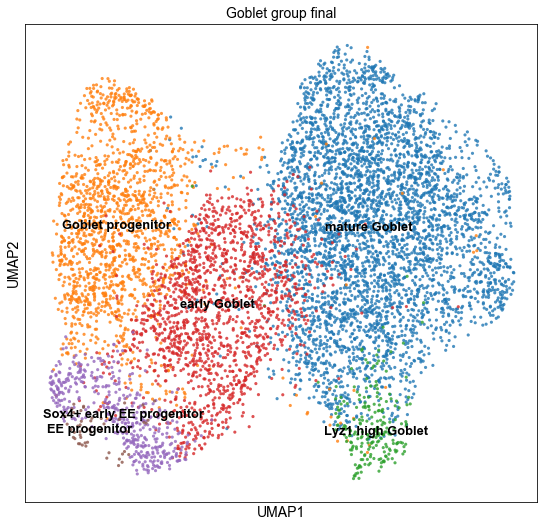

In [76]:
rcParams['figure.figsize']=(8,8)
sc.pl.umap(a_goblet, color='Goblet_group_final', size=40, legend_loc='on data', alpha=0.8)

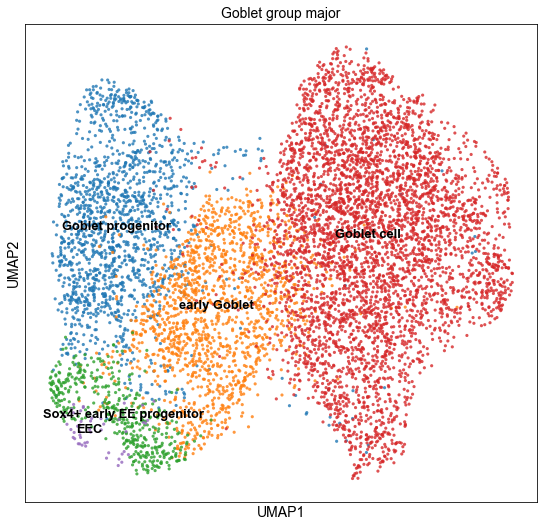

In [77]:
rcParams['figure.figsize']=(8,8)
sc.pl.umap(a_goblet, color='Goblet_group_major', size=40, legend_loc='on data', alpha=0.8)

### Summary

For the Goblet cells, we have been able to identify some progenitor cells expressing *Lgr5* and *Sox4*, respectively. Furthermore, we see a direct connection of progenitor cells and differentiated cells through cell cycle exit, *i.e.* mature Goblet cells do not proliferate. 

Also, we see a *Lyz1* positive population (approx. 200 cells) branching off from mature Goblet cells.

Merge subtype annotation into the full data set.

In [79]:
pd.crosstab(adata_ctrl.obs['refined_clustering'], adata_ctrl.obs['cell_type'])

cell_type,EEC,Enterocyte,Enterocyte progenitor,Goblet,ISC,Paneth,Tuft
refined_clustering,,,,,,,
EEC,2383,0,0,0,0,0,0
Enterocyte,0,5294,444,0,119,0,0
Enterocyte progenitor,0,259,5784,0,4662,0,0
Goblet,0,0,0,7848,0,0,0
ISC,0,2,341,0,8495,0,0
Paneth,0,0,0,0,0,16796,0
Paneth primed ISC,0,6,891,0,825,0,0
Tuft,0,0,0,0,0,0,2143


In [80]:
adata_ctrl.obs['refined_clustering'] = pd.concat(
    [a_goblet.obs['Goblet_group_major'], 
     adata_ctrl.obs['refined_clustering'][np.invert(np.in1d(adata_ctrl.obs['refined_clustering'],
                                                      ['Goblet']))]])

In [81]:
pd.value_counts(adata_ctrl.obs['refined_clustering'])

Paneth                       16796
Enterocyte progenitor        10705
ISC                           8838
Enterocyte                    5857
Goblet cell                   4335
EEC                           2430
Tuft                          2143
Paneth primed ISC             1722
Goblet progenitor             1512
early Goblet                  1511
Sox4+ early EE progenitor      443
Name: refined_clustering, dtype: int64

## Resolve Paneth cell clusters

Select Paneth cells.

In [82]:
paneth_idx = np.in1d(adata_ctrl.obs['cell_type'],'Paneth')
a_Paneth = adata_ctrl[paneth_idx,:]

In [83]:
sc.tl.pca(a_Paneth, svd_solver='arpack')
sc.pp.neighbors(a_Paneth, n_neighbors=30)
#sc.tl.tsne(a_Paneth, use_fast_tsne=False)
sc.tl.umap(a_Paneth)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:15.77) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:00:17.52) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [84]:
a_Paneth

AnnData object with n_obs × n_vars = 16796 × 2000 
    obs: 'sample', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'genetics', 'S_score', 'G2M_score', 'phase', 'louvain', 'cell_type', 'ISC_score', 'EEC_score', 'Enterocyte_score', 'PC_score', 'GC_score', 'Tuft_score', 'refined_clustering'
    var: 'mean', 'dispersion'
    uns: 'cell_type_colors', 'louvain', 'louvain_colors', 'neighbors', 'paga', 'pca', 'phase_colors', 'rank_genes_groups', 'refined_clustering_colors', 'refined_clustering_sizes', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

### Visualise marker gene expression

Define a list of known Paneth cell marker genes for plotting.

In [85]:
gene_names_Paneth = ['Mmp7',  'Lyz1', 'Lyz2', 'Mptx1', 'Mptx2', #Paneth cell marker
                     'Lgr5', 'Ascl2', 'Olfm4', 'Sox4', #stem cell marker
                     'Reg4', 'Nupr1', 'Itln1', 
                     'Tff3', 'Agr2', 'Muc2', #Goblet marker
                     #'Lbh', 'Fos'  #Transcription factor
                    ]

... storing 'refined_clustering' as categorical


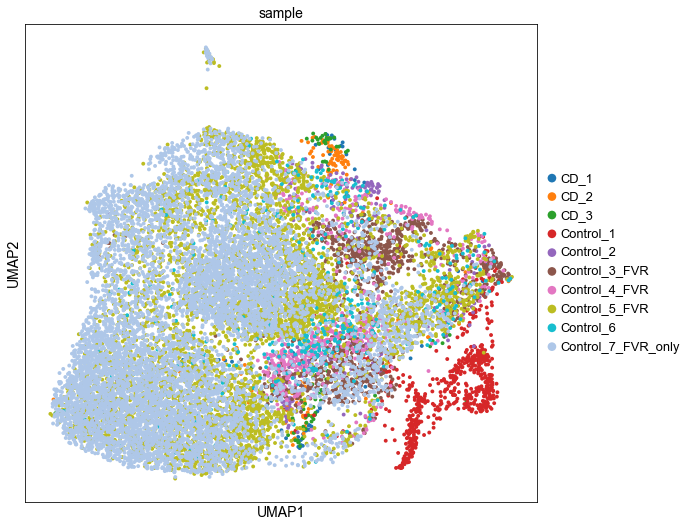

In [86]:
rcParams['figure.figsize']=(8,8)
sc.pl.umap(a_Paneth, color='sample', size=60)

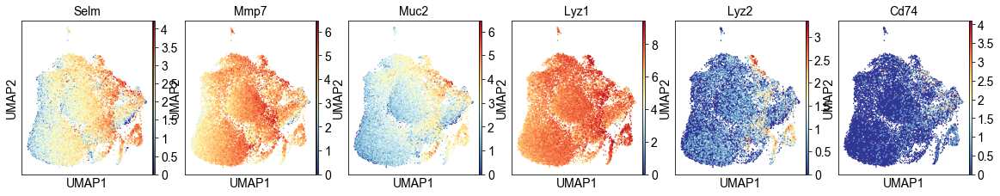

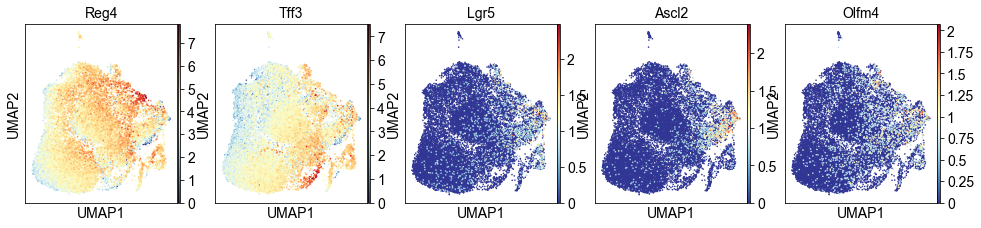

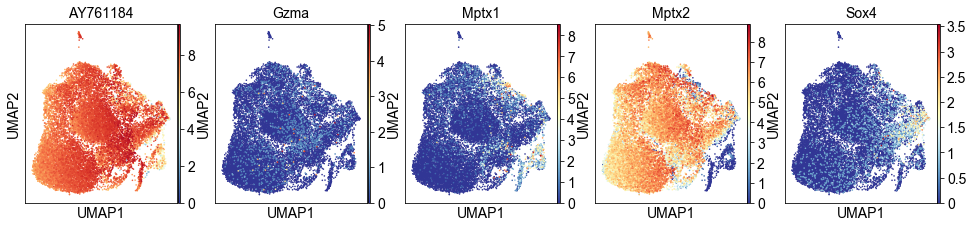

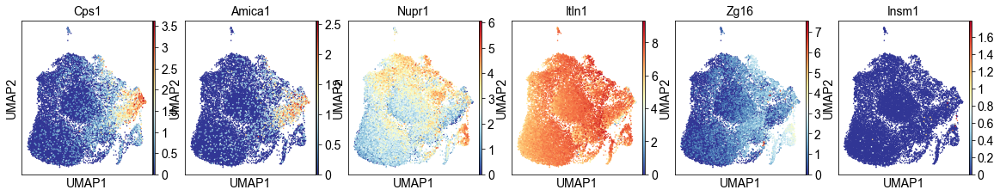

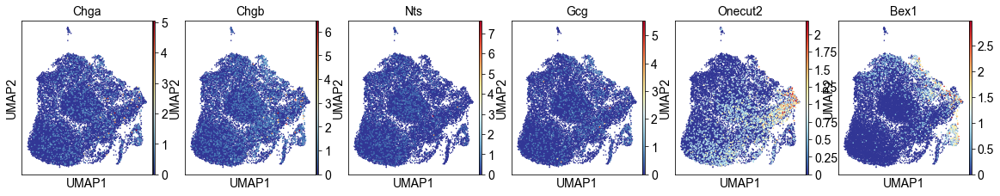

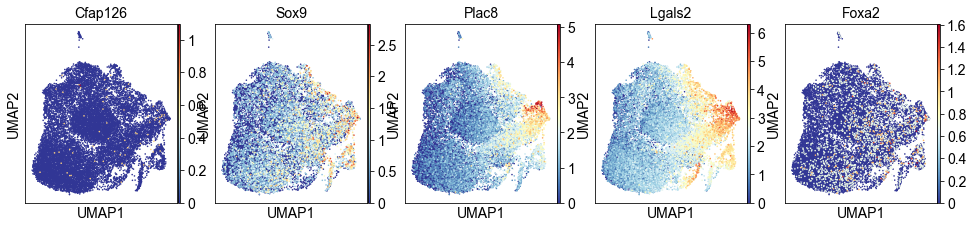

In [87]:
rcParams['figure.figsize']=(3,3)
sc.pl.umap(a_Paneth, color=['Selm', 'Mmp7','Muc2', 'Lyz1', 'Lyz2', 'Cd74'], size=10)
sc.pl.umap(a_Paneth, color=['Reg4', 'Tff3', 'Lgr5', 'Ascl2', 'Olfm4'], size=10)
sc.pl.umap(a_Paneth, color=['AY761184', 'Gzma', 'Mptx1', 'Mptx2',  'Sox4'], size=10)
sc.pl.umap(a_Paneth, color=['Cps1', 'Amica1', 'Nupr1', 'Itln1', 'Zg16', 'Insm1'], size=10)
sc.pl.umap(a_Paneth, color=[ 'Chga', 'Chgb', 'Nts', 'Gcg', 'Onecut2', 'Bex1'], size=10)
sc.pl.umap(a_Paneth, color=['Cfap126', 'Sox9', 'Plac8', 'Lgals2', 'Foxa2'], size=10)


### Clustering

In [88]:
sc.tl.louvain(a_Paneth, resolution=1.5)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:01.84) --> found 14 clusters and added
    'louvain', the cluster labels (adata.obs, categorical)


In [89]:
pd.crosstab(a_Paneth.obs['sample'],a_Paneth.obs['louvain'])

louvain,0,1,2,3,4,5,6,7,8,9,10,11,12,13
sample,,,,,,,,,,,,,,
CD_1,3,0,0,25,0,0,12,8,0,5,30,0,0,0
CD_2,1,0,0,61,4,0,12,21,5,2,51,1,4,0
CD_3,2,0,0,27,1,0,3,12,6,4,39,2,0,0
Control_1,0,0,0,2,0,0,0,70,30,4,13,505,3,0
Control_2,1,0,0,81,1,0,0,28,52,15,59,7,8,0
Control_3_FVR,6,11,6,8,7,2,4,205,294,437,90,3,9,0
Control_4_FVR,1,2,0,97,1,3,1,73,224,52,132,4,16,0
Control_5_FVR,691,613,797,583,560,767,512,511,75,33,33,1,63,14
Control_6,13,9,21,76,22,12,19,65,120,11,21,0,6,0


    number of colors in `.uns[louvain'_colors']` smaller than number of categories, falling back to palette


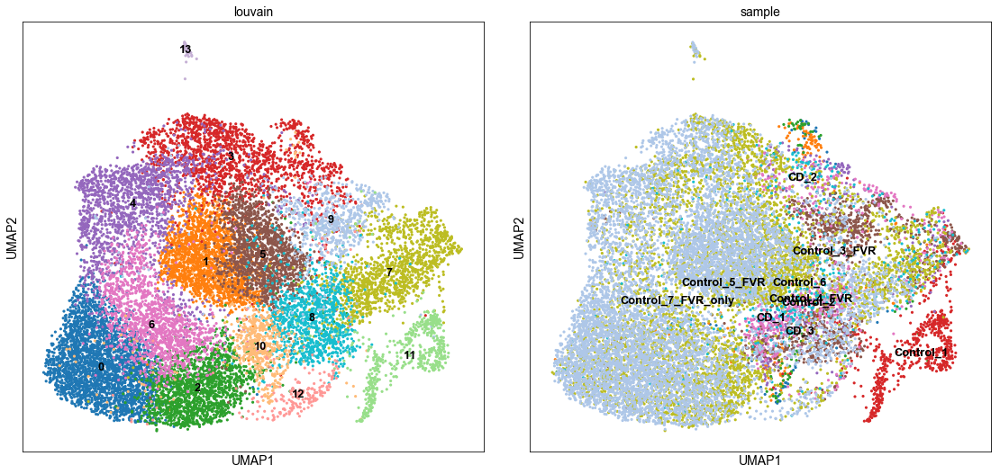

In [90]:
rcParams['figure.figsize']=(8,8)
#sc.pl.tsne(a_Paneth, color=['louvain', 'sample'], size=40)
sc.pl.umap(a_Paneth, color=['louvain', 'sample'], size=40, legend_loc='on data')

### Subcluster clusters 3, 9 and 11

In [91]:
sc.tl.louvain(a_Paneth,resolution=2, restrict_to=['louvain', ['3', '9', '11']])

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.19) --> found 17 clusters and added
    'louvain_R', the cluster labels (adata.obs, categorical)


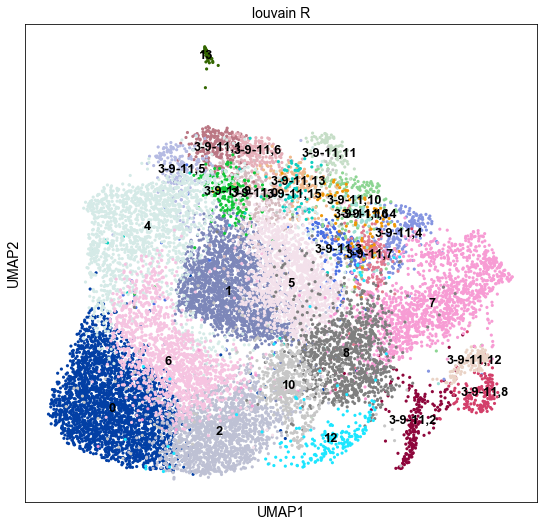

In [92]:
rcParams['figure.figsize']=(8,8)
sc.pl.umap(a_Paneth, color='louvain_R',size=40, legend_loc='on data')

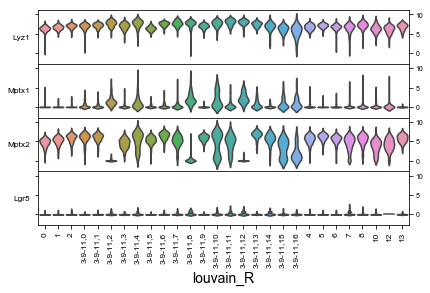

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a34cde358>,
      dtype=object)

In [93]:
rcParams['figure.figsize']=(10,5)
sc.pl.stacked_violin(a_Paneth, groupby='louvain_R', 
                     var_names=['Lyz1', 'Mptx1', 'Mptx2', 'Lgr5'], swap_axes=True)

In [94]:
sc.tl.rank_genes_groups(a_Paneth, groupby='louvain_R')

ranking genes
    finished (0:00:29.53) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids


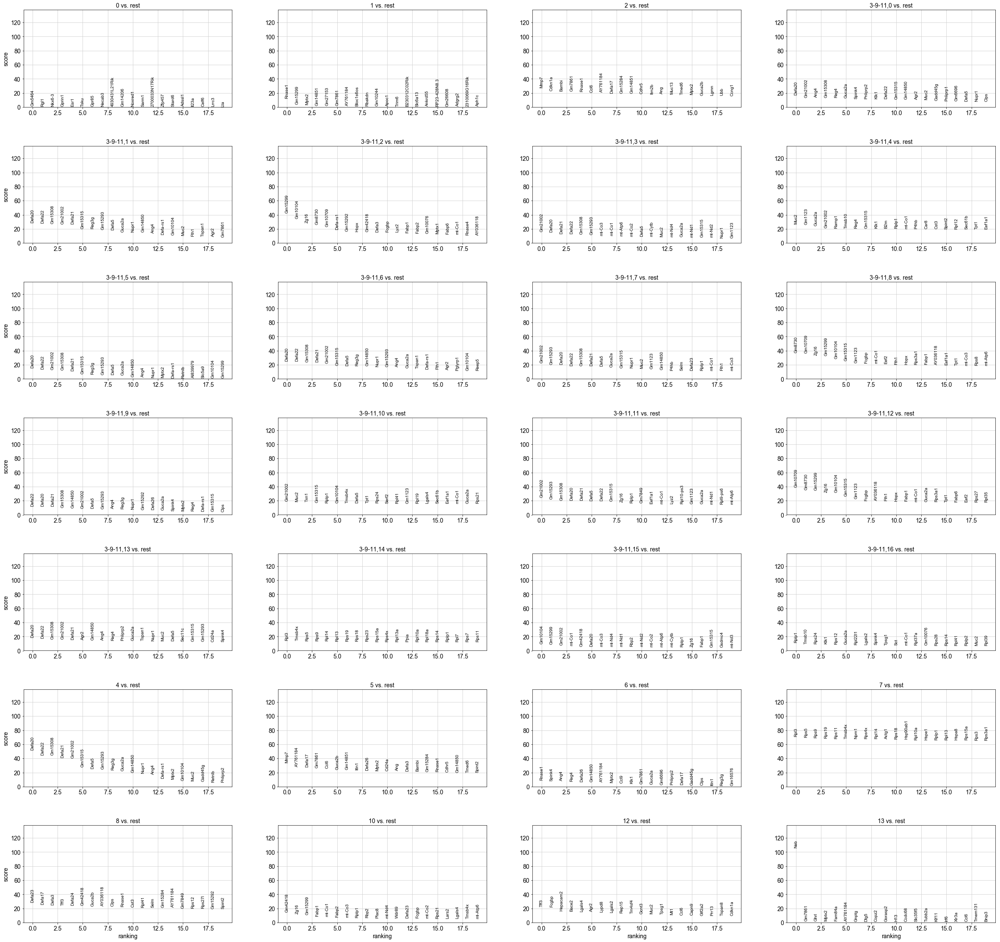

In [95]:
sc.pl.rank_genes_groups(a_Paneth, fontsize=10)

### Compute graph on fully refined Paneth cell clustering

In [96]:
np.flatnonzero(np.in1d(a_Paneth.obs['louvain'], '7'))[:10]

array([15, 19, 27, 41, 50, 60, 64, 67, 73, 80])

In [97]:
a_Paneth.uns['iroot'] = 15
sc.tl.paga(a_Paneth, groups='louvain_R')
sc.tl.diffmap(a_Paneth)
sc.tl.dpt(a_Paneth)

running partition-based graph abstraction (PAGA)
    finished (0:00:02.38) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
computing Diffusion Maps using n_comps=15(=n_dcs)
    eigenvalues of transition matrix
    [1.         0.98763764 0.98004013 0.975007   0.9705786  0.96611667
     0.9573633  0.95537585 0.9472424  0.9428412  0.938165   0.936576
     0.9264593  0.9199338  0.91870046]
    finished (0:00:00.96) --> added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns)
computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00.00) --> added
    'dpt_pseudotime', the pseudotime (adata.obs)


/Users/Maren.Buettner/miniconda3/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:856: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(row)


How many cell do we have per cluster?

In [98]:
pd.value_counts(a_Paneth.obs['louvain_R'])

0            2896
1            1940
2            1629
4            1591
5            1474
6            1375
7            1325
8            1028
10            525
3-9-11,0      262
3-9-11,1      247
3-9-11,2      215
3-9-11,3      215
3-9-11,4      201
12            199
3-9-11,5      188
3-9-11,6      179
3-9-11,7      178
3-9-11,8      171
3-9-11,9      162
3-9-11,10     151
3-9-11,11     135
3-9-11,12     131
3-9-11,13     128
3-9-11,14      84
3-9-11,15      77
3-9-11,16      54
13             36
Name: louvain_R, dtype: int64

Plot graph abstraction result.

--> added 'pos', the PAGA positions (adata.uns['paga'])


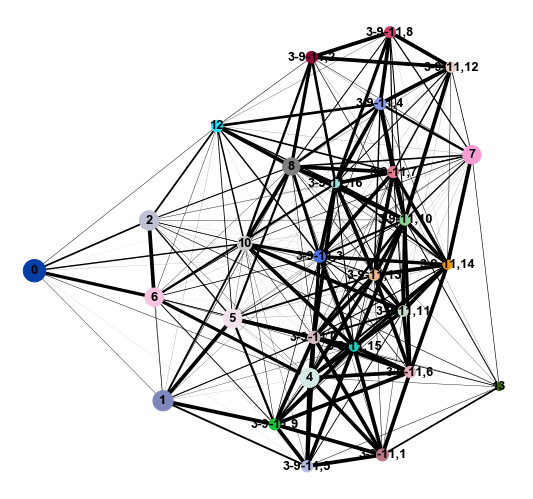

In [99]:
rcParams['figure.figsize']=(8,8)
sc.pl.paga(a_Paneth, frameon=False, edge_width_scale=0.5)

### Summarise results

In [100]:
genes_to_xls(adata=a_Paneth, filename='./../table/Paneth_refined_sep.xls')

Create a vector of gene names for visualisation of gene expression per group in a heatmap.

In [101]:
df = np.array([])
for i in a_Paneth.uns['rank_genes_groups']['names'].dtype.names:
    d = a_Paneth.uns['rank_genes_groups']['names'][i][:15]
    df = np.concatenate([df,d])

In [102]:
genes_Paneth = pd.value_counts(df).index

In [103]:
genes_Paneth

Index(['Gm21002', 'Guca2a', 'Defa20', 'Gm15315', 'Gm15308', 'Defa5', 'Defa22',
       'Defa21', 'Gm14850', 'mt-Co1',
       ...
       'Rps28', 'Gm6696', 'Nkx6-3', 'Zfp457', 'Eef1a1', 'Copz2', 'Noxred1',
       'Cd24a', 'Actg1', 'Wdr89'],
      dtype='object', length=166)

In [104]:
genes_Paneth_idx = np.flatnonzero(np.in1d(a_Paneth.var_names, genes_Paneth))


### Visualise differentially expressed genes and annotate clusters

Group genes by similarity through hierarchical clustering.

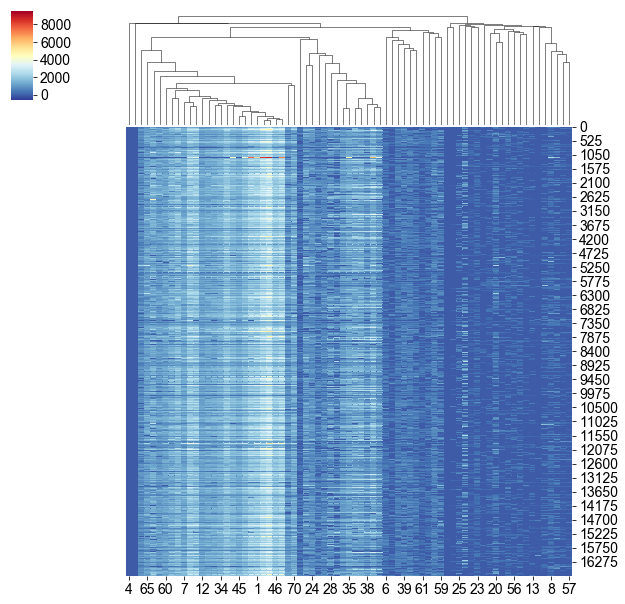

In [105]:
g=sns.clustermap(a_Paneth.X[:,genes_Paneth_idx].todense(),
                 cmap="RdYlBu_r",row_cluster=False,metric='correlation')

In [106]:
gene_names_diff=a_Paneth[:,genes_Paneth_idx].var_names[g.dendrogram_col.reordered_ind]

Plot differential genes, group cells by clusters.

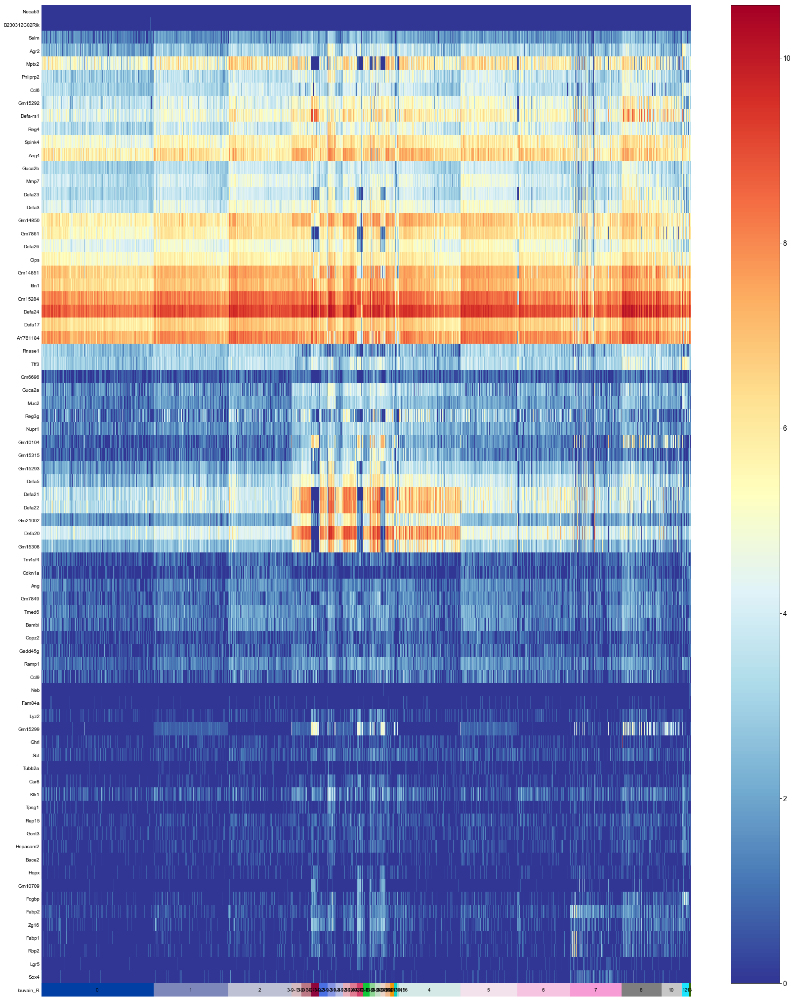

In [107]:
rcParams['figure.figsize']=(30,35)
sc.pl.paga_path(a_Paneth, keys=np.concatenate([gene_names_diff, ['Lgr5', 'Sox4']]),annotations=[],
                nodes=a_Paneth.obs['louvain_R'].cat.categories,color_map="RdYlBu_r")


Plot some Paneth cell marker gene expression in separated heatmaps. They are not exclusively Paneth cell markers (that would be boring) but stem cell and Goblet cell markers as well. 

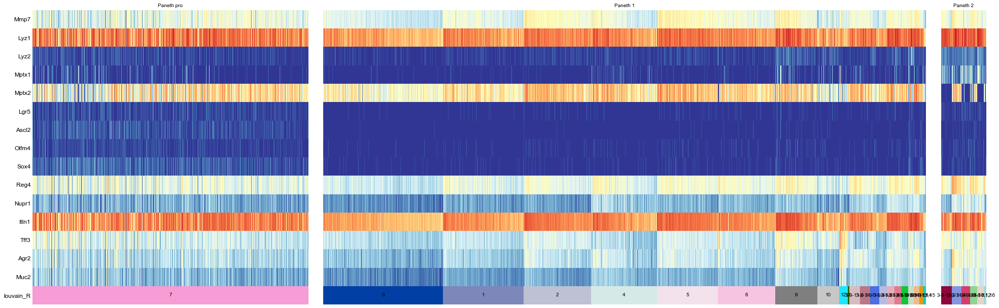

In [108]:
paths = [('Paneth pro', ['7']),         
         ('Paneth 1', ['0', '1','2', '4', '5','6','8', '10', '12', '13',
                       '3-9-11,0', '3-9-11,1', '3-9-11,3','3-9-11,5',
                       '3-9-11,6', '3-9-11,7', '3-9-11,9', '3-9-11,11', 
                       '3-9-11,13', '3-9-11,14','3-9-11,15'
                      ]),
         ('Paneth 2',['3-9-11,2', '3-9-11,4', '3-9-11,8',
                      '3-9-11,10', '3-9-11,12', '3-9-11,16'
                     ]),

]

path_ratios= pd.value_counts(a_Paneth.obs['louvain_R']).values
path_cat = pd.value_counts(a_Paneth.obs['louvain_R']).index
tmp=np.zeros(len(paths))
for ipath, (descr, path) in enumerate(paths):
    #print(path[1])
    idx = np.flatnonzero(np.in1d(path_cat, path))[0]
    #print(idx)
    tmp[ipath] = path_ratios[idx]
    
tmp = tmp.astype('int')
path_ratios = tmp / tmp.sum() *len(path_ratios)

_, axs = pl.subplots(ncols=len(tmp), figsize=(30, 10), 
                     gridspec_kw={'wspace': 0.05, 'left': 0.11,'width_ratios':path_ratios})
pl.subplots_adjust(left=0.05, right=0.98, top=0.88)
for ipath, (descr, path) in enumerate(paths):
    sc.pl.paga_path(a_Paneth, left_margin=0.3, ytick_fontsize=12, color_map='RdYlBu_r',
                   nodes=path, ax=axs[ipath],
                   keys=np.concatenate([gene_names_Paneth]),
                   annotations=[],
                   show_yticks=True if ipath==0 else False,
                   show_colorbar=False,                        
                   n_avg=2,
                   title='{}'.format(descr),
                   show=False)
#pl.savefig('./figures/aga_EEC.png', dpi=300)
pl.show()

### Rename and merge groups

**In total:**
We have identified the Paneth cell progenitors and mature Paneth cells. Among the Paneth cell clusters, we observe a `Mptx2` negative population, which is `Mptx1` positive. Let us further merge the following clusters:

* `7`  -> `Paneth progenitor` (*Lgr5* positive)
* `0`-`2`, `4`-`6`,`8`,`10` and `12`, `13`   -> `Paneth 1`
* subclusters from `3`, `9` and `11` -> `Paneth 2`

In [109]:
a_Paneth.obs['Paneth_group_final']=a_Paneth.obs['louvain_R']
a_Paneth.obs['Paneth_group_final']= a_Paneth.obs['Paneth_group_final'].cat.add_categories(
    ['Paneth pro', 'Paneth 1', 'Paneth 2'])
a_Paneth.obs['Paneth_group_final'][np.in1d(a_Paneth.obs['louvain_R'], 
                                  ['0', '1','2', '4', '5','6','8', '10', '12', '13',
                       '3-9-11,0', '3-9-11,1', '3-9-11,3','3-9-11,5',
                       '3-9-11,6', '3-9-11,7', '3-9-11,9', '3-9-11,11', 
                       '3-9-11,13', '3-9-11,14','3-9-11,15'
                                  ])] = np.repeat(
    'Paneth 1', np.in1d(a_Paneth.obs['louvain_R'], 
                        ['0', '1','2', '4', '5','6','8', '10', '12', '13',
                       '3-9-11,0', '3-9-11,1', '3-9-11,3','3-9-11,5',
                       '3-9-11,6', '3-9-11,7', '3-9-11,9', '3-9-11,11', 
                       '3-9-11,13', '3-9-11,14','3-9-11,15']).sum())
a_Paneth.obs['Paneth_group_final'][np.in1d(a_Paneth.obs['louvain_R'], 
                                           ['3-9-11,2', '3-9-11,4', '3-9-11,8',
                      '3-9-11,10', '3-9-11,12', '3-9-11,16'])] = np.repeat(
    'Paneth 2', np.in1d(a_Paneth.obs['louvain_R'], ['3-9-11,2', '3-9-11,4', '3-9-11,8',
                      '3-9-11,10', '3-9-11,12', '3-9-11,16']).sum())
a_Paneth.obs['Paneth_group_final'][np.in1d(a_Paneth.obs['louvain_R'], 
                                     ['7'])] = np.repeat(
    'Paneth pro', np.in1d(a_Paneth.obs['louvain_R'],  ['7']).sum())


a_Paneth.obs['Paneth_group_final']=a_Paneth.obs['Paneth_group_final'].cat.remove_unused_categories()

In [110]:
a_Paneth.obs['Paneth_group_final'].cat.categories

Index(['Paneth pro', 'Paneth 1', 'Paneth 2'], dtype='object')

How many cells do we have per cluster?

In [111]:
pd.value_counts(a_Paneth.obs['Paneth_group_final'])

Paneth 1      14548
Paneth pro     1325
Paneth 2        923
Name: Paneth_group_final, dtype: int64

Repeat the gene ranking (differential expression test) for the final clustering.

In [112]:
sc.tl.rank_genes_groups(a_Paneth, groupby='Paneth_group_final')

ranking genes
    finished (0:00:03.55) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids


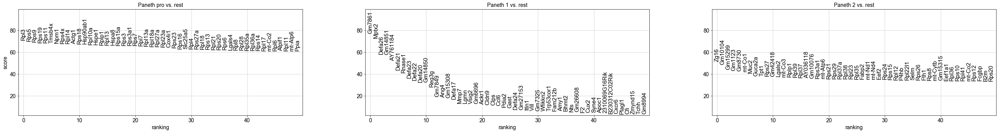

In [113]:
rcParams['figure.figsize']=(15,5)
sc.pl.rank_genes_groups(a_Paneth, fontsize=15, n_genes=50)

Create gene list for the differential test above and group genes by expression similarity.

In [114]:
df = np.array([])
for i in a_Paneth.uns['rank_genes_groups']['names'].dtype.names:
    d = a_Paneth.uns['rank_genes_groups']['names'][i][:30]
    df = np.concatenate([df,d])

In [115]:
genes_Paneth_final = pd.value_counts(df).index

In [116]:
genes_Paneth_final_idx = np.flatnonzero(np.in1d(a_Paneth.var_names, genes_Paneth_final))


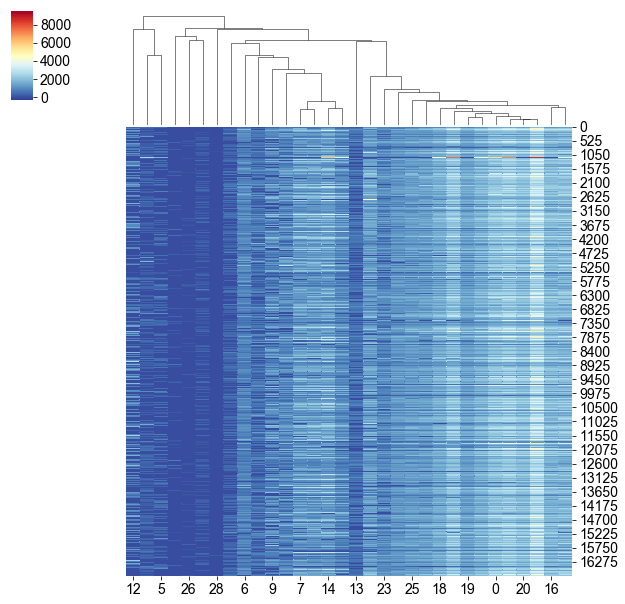

In [117]:
g=sns.clustermap(a_Paneth.X[:,genes_Paneth_final_idx].todense(),
                 cmap="RdYlBu_r",row_cluster=False,metric='correlation')

In [118]:
gene_names_diff=a_Paneth[:,genes_Paneth_final_idx].var_names[g.dendrogram_col.reordered_ind]

In [120]:
a_Paneth.uns['iroot'] = 15
sc.tl.paga(a_Paneth, groups='Paneth_group_final')
sc.tl.diffmap(a_Paneth)
sc.tl.dpt(a_Paneth)

running partition-based graph abstraction (PAGA)
    finished (0:00:00.97) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
computing Diffusion Maps using n_comps=15(=n_dcs)
    eigenvalues of transition matrix
    [1.         0.98763764 0.98004013 0.975007   0.9705786  0.96611667
     0.9573633  0.95537585 0.9472424  0.9428412  0.938165   0.936576
     0.9264593  0.9199338  0.91870046]
    finished (0:00:00.80) --> added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns)
computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00.00) --> added
    'dpt_pseudotime', the pseudotime (adata.obs)


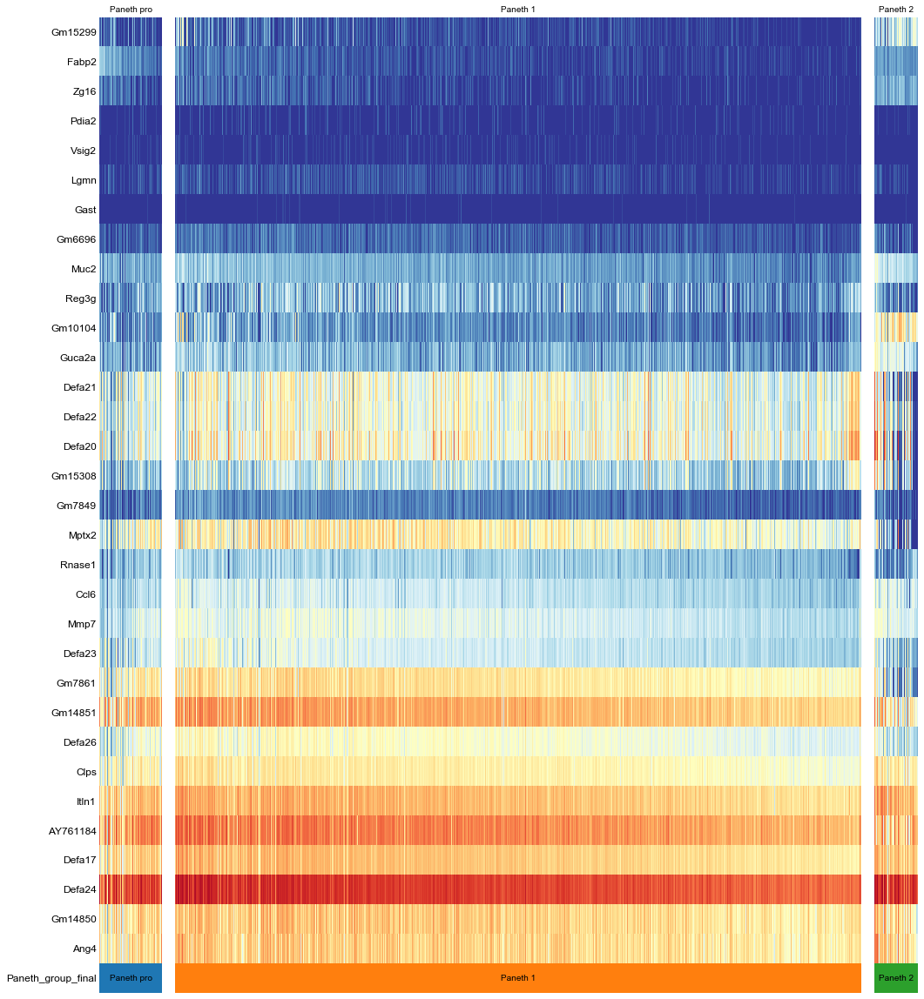

In [121]:
paths = [('Paneth pro', ['Paneth pro']),
         ('Paneth 1', ['Paneth 1']),
         ('Paneth 2', ['Paneth 2']),
]

path_ratios= pd.value_counts(a_Paneth.obs['Paneth_group_final']).values
path_cat = pd.value_counts(a_Paneth.obs['Paneth_group_final']).index
tmp=np.zeros(len(a_Paneth.obs['Paneth_group_final'].cat.categories))
for ipath, (descr, path) in enumerate(paths):
    #print(path[1])
    idx = np.flatnonzero(np.in1d(path_cat, path))
    #print(idx)
    tmp[ipath] = path_ratios[idx]
    
tmp = tmp.astype('int')
#path_ratios = np.asarray([path_ratios[i] for i in tmp])
path_ratios = tmp / tmp.sum() *len(path_ratios)
#path_ratios= pd.value_counts(a_EEC.obs['louvain_groups'])
#tmp=np.zeros(len(a_EEC.obs['louvain_groups'].cat.categories))
#for ipath, (descr, path) in enumerate(paths):
    #print(path[1])
#    tmp[ipath] = path[0]
    
#tmp = tmp.astype('int')
#path_ratios = np.asarray([path_ratios[i] for i in tmp])
#path_ratios = path_ratios / path_ratios.sum() *len(tmp)

_, axs = pl.subplots(ncols=len(tmp), figsize=(15, 20), 
                     gridspec_kw={'wspace': 0.05, 'left': 0.11,'width_ratios':path_ratios})
pl.subplots_adjust(left=0.05, right=0.98, top=0.88)
for ipath, (descr, path) in enumerate(paths):
    sc.pl.paga_path(a_Paneth, left_margin=0.3, ytick_fontsize=12, color_map='RdYlBu_r',
                   nodes=path, ax=axs[ipath],
                   keys=np.concatenate([gene_names_diff]),
                   annotations=[],
                   show_yticks=True if ipath==0 else False,
                   show_colorbar=False,                        
                   n_avg=2,
                   title='{}'.format(descr),
                   show=False)
#pl.savefig('./figures/aga_EEC.png', dpi=300)
pl.show()

Save final clustering to file.

In [122]:
a_Paneth.obs['Paneth_group_final'].to_csv('./../data/Paneth_refined_clustering.csv')

### Summary

Paneth cells are apparently very homogeneous. We have identified 3 major cell clusters of maturing Paneth cell populations as well as mature Paneth cells. There is a large *Lyz2* positive population that is mutually exclusive with the *Mptx2* positive Paneth cell population. 

Merge subtype annotation into the full data set.

In [123]:
pd.crosstab(adata_ctrl.obs['refined_clustering'], adata_ctrl.obs['cell_type'])

cell_type,EEC,Enterocyte,Enterocyte progenitor,Goblet,ISC,Paneth,Tuft
refined_clustering,,,,,,,
EEC,2383,0,0,47,0,0,0
Enterocyte,0,5294,444,0,119,0,0
Enterocyte progenitor,0,259,5784,0,4662,0,0
Goblet cell,0,0,0,4335,0,0,0
Goblet progenitor,0,0,0,1512,0,0,0
ISC,0,2,341,0,8495,0,0
Paneth,0,0,0,0,0,16796,0
Paneth primed ISC,0,6,891,0,825,0,0
Sox4+ early EE progenitor,0,0,0,443,0,0,0


In [124]:
adata_ctrl.obs['refined_clustering'] = pd.concat(
    [a_Paneth.obs['Paneth_group_final'], 
     adata_ctrl.obs['refined_clustering'][np.invert(np.in1d(adata_ctrl.obs['refined_clustering'],
                                                      ['Paneth']))]])

In [125]:
pd.value_counts(adata_ctrl.obs['refined_clustering'])

Paneth 1                     14548
Enterocyte progenitor        10705
ISC                           8838
Enterocyte                    5857
Goblet cell                   4335
EEC                           2430
Tuft                          2143
Paneth primed ISC             1722
Goblet progenitor             1512
early Goblet                  1511
Paneth pro                    1325
Paneth 2                       923
Sox4+ early EE progenitor      443
Name: refined_clustering, dtype: int64

## Refine Tuft cells 

This chapter covers an additional part as we are not genuinely interested in Tuft cells.

In [126]:
a_Tuft_idx = np.in1d(adata_ctrl.obs['cell_type'], 'Tuft')
a_Tuft = adata_ctrl[a_Tuft_idx,:]

In [127]:
sc.tl.pca(a_Tuft)
sc.pp.neighbors(a_Tuft)
sc.tl.umap(a_Tuft, min_dist=0.09)
sc.tl.diffmap(a_Tuft)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing neighbors
    using 'X_pca' with n_pcs = 50


/Users/Maren.Buettner/miniconda3/lib/python3.6/site-packages/sklearn/metrics/pairwise.py:257: RuntimeWarning: invalid value encountered in sqrt
  return distances if squared else np.sqrt(distances, out=distances)


    finished (0:00:00.96) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:00:03.99) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing Diffusion Maps using n_comps=15(=n_dcs)
    eigenvalues of transition matrix
    [1.         0.9872022  0.9712558  0.95917416 0.9534175  0.9499836
     0.9345825  0.91716254 0.910551   0.90291107 0.89831436 0.8817915
     0.86803055 0.865636   0.8602708 ]
    finished (0:00:00.06) --> added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns)


... storing 'refined_clustering' as categorical


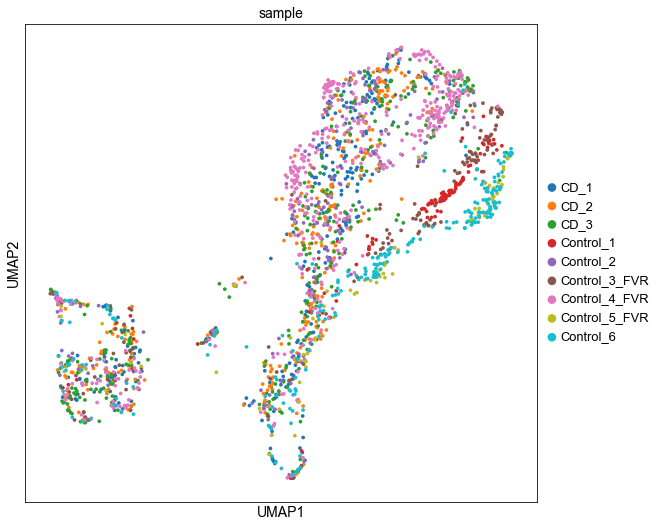

In [128]:
rcParams['figure.figsize']=(8,8)
sc.pl.umap(a_Tuft, color=['sample'])

### Visualise marker gene expression

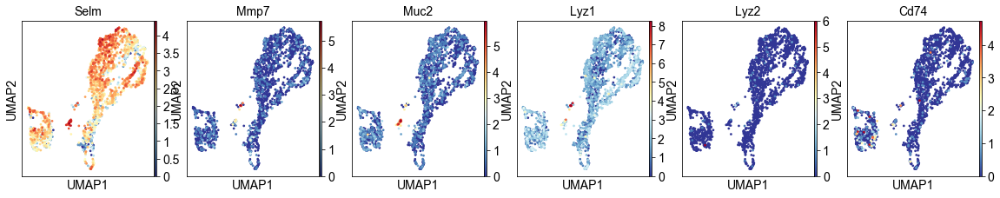

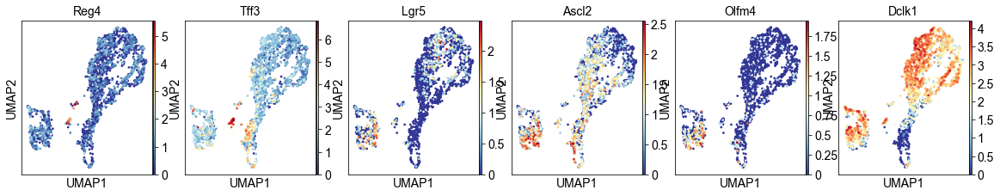

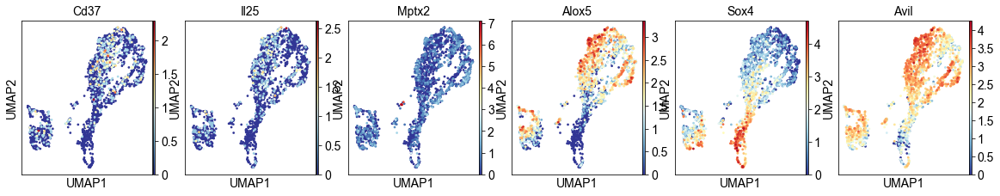

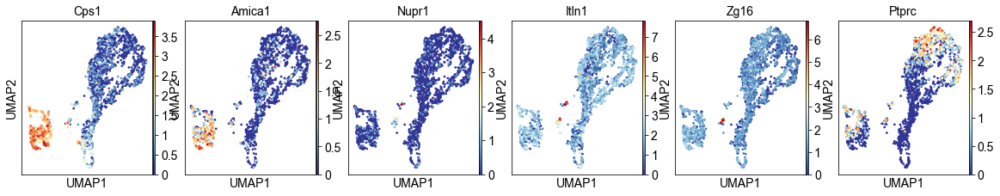

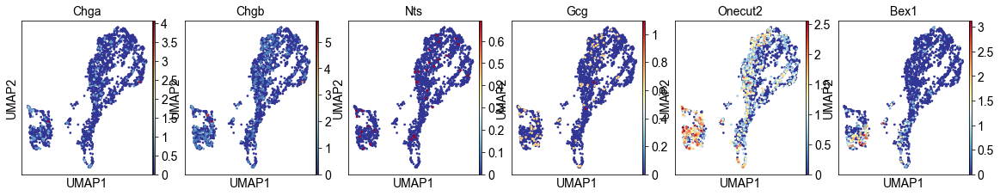

In [129]:
rcParams['figure.figsize']=(3,3)
sc.pl.umap(a_Tuft, color=['Selm', 'Mmp7','Muc2', 'Lyz1', 'Lyz2', 'Cd74'], size=30)
sc.pl.umap(a_Tuft, color=['Reg4', 'Tff3', 'Lgr5', 'Ascl2', 'Olfm4', 'Dclk1'], size=30)
sc.pl.umap(a_Tuft, color=['Cd37', 'Il25' ,'Mptx2','Alox5', 'Sox4', 'Avil'], size=30)
sc.pl.umap(a_Tuft, color=['Cps1', 'Amica1', 'Nupr1', 'Itln1', 'Zg16', 'Ptprc'], size=30)
sc.pl.umap(a_Tuft, color=[ 'Chga', 'Chgb', 'Nts', 'Gcg', 'Onecut2', 'Bex1'], size=30)

In [130]:
a_Tuft

AnnData object with n_obs × n_vars = 2143 × 2000 
    obs: 'sample', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'genetics', 'S_score', 'G2M_score', 'phase', 'louvain', 'cell_type', 'ISC_score', 'EEC_score', 'Enterocyte_score', 'PC_score', 'GC_score', 'Tuft_score', 'refined_clustering'
    var: 'mean', 'dispersion'
    uns: 'cell_type_colors', 'louvain', 'louvain_colors', 'neighbors', 'paga', 'pca', 'phase_colors', 'rank_genes_groups', 'refined_clustering_colors', 'refined_clustering_sizes', 'sample_colors', 'diffmap_evals'
    obsm: 'X_pca', 'X_umap', 'X_diffmap'
    varm: 'PCs'

### Clustering and refined lineage tree

In [131]:
sc.tl.louvain(a_Tuft, resolution=1.2)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.11) --> found 11 clusters and added
    'louvain', the cluster labels (adata.obs, categorical)


    number of colors in `.uns[louvain'_colors']` smaller than number of categories, falling back to palette


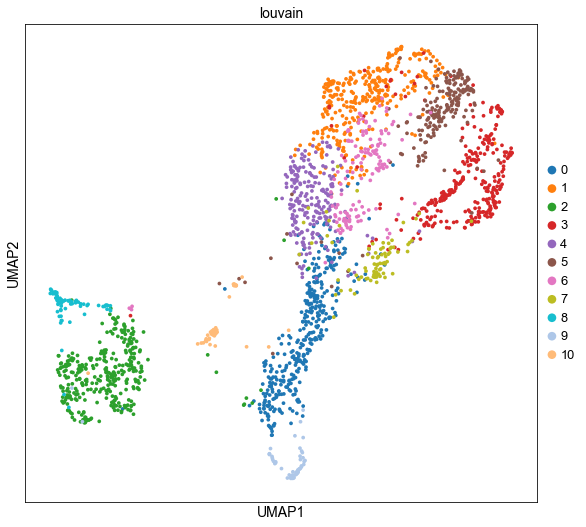

In [132]:
rcParams['figure.figsize']=(8,8)
sc.pl.umap(a_Tuft, color='louvain')

Note: Cluster 10 shows marker gene expression of both Goblet cells and Tuft cells. We suspect that these cells represent doublets, which have not been excluded in prior steps. Therefore, we will subsequently remove these cells.

In [133]:
np.flatnonzero(np.in1d(a_Tuft.obs['louvain'], '9'))[:10]

array([ 51, 120, 181, 242, 321, 339, 356, 433, 441, 508])

In [134]:
a_Tuft.uns['iroot']=51
sc.tl.paga(a_Tuft, groups='louvain')
sc.tl.dpt(a_Tuft)

running partition-based graph abstraction (PAGA)
    finished (0:00:00.14) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00.00) --> added
    'dpt_pseudotime', the pseudotime (adata.obs)


--> added 'pos', the PAGA positions (adata.uns['paga'])


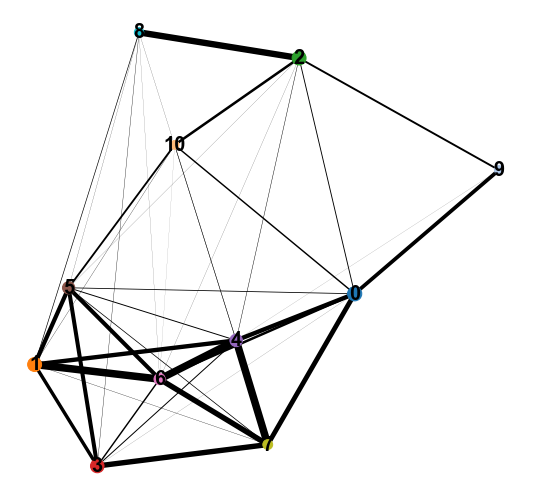

In [135]:
rcParams['figure.figsize']=(8,8)
sc.pl.paga(a_Tuft, frameon=False, fontsize=20)

In [136]:
sc.tl.rank_genes_groups(a_Tuft, groupby='louvain')

ranking genes
    finished (0:00:03.03) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids


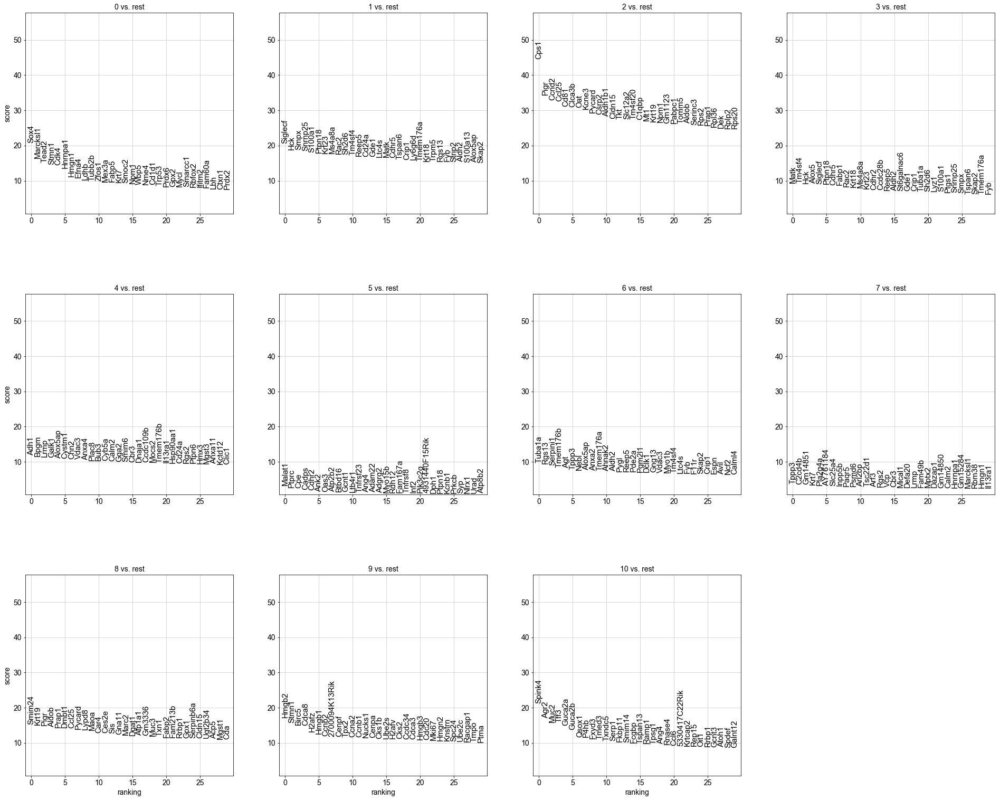

In [137]:
rcParams['figure.figsize']=(8,8)
sc.pl.rank_genes_groups(a_Tuft, fontsize=15, n_genes=30)

In [138]:
df = np.array([])
for i in a_Tuft.uns['rank_genes_groups']['names'].dtype.names:
    d = a_Tuft.uns['rank_genes_groups']['names'][i][:15]
    df = np.concatenate([df,d])

In [139]:
genes_tuft = pd.value_counts(df).index

In [140]:
genes_tuft

Index(['Reep5', 'Pycard', 'Alox5ap', 'Ccl25', 'Pigr', 'Rac2', 'Krt23', 'Krt7',
       'Ptpn18', 'Cdhr2',
       ...
       'Ccnb2', 'Ltb4r1', 'Adam22', 'Gna11', 'Cdk4', 'Ces2e', 'Arl2bp',
       'Sh2d6', 'Guca2b', 'Dmbt1'],
      dtype='object', length=148)

In [141]:
genes_tuft_idx = np.flatnonzero(np.in1d(a_Tuft.var_names, genes_tuft))


Sort the differentially expressed genes by hierarchical clustering, *i.e.* by similar expression patterns. 

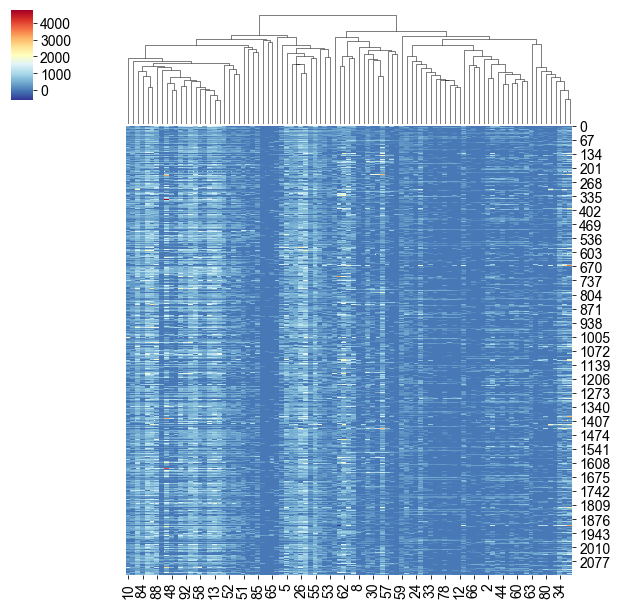

In [142]:
g=sns.clustermap(a_Tuft.X[:,genes_tuft_idx].todense(),cmap="RdYlBu_r",row_cluster=False,metric='correlation')

In [143]:
gene_names_diff=a_Tuft[:,genes_tuft_idx].var_names[g.dendrogram_col.reordered_ind]

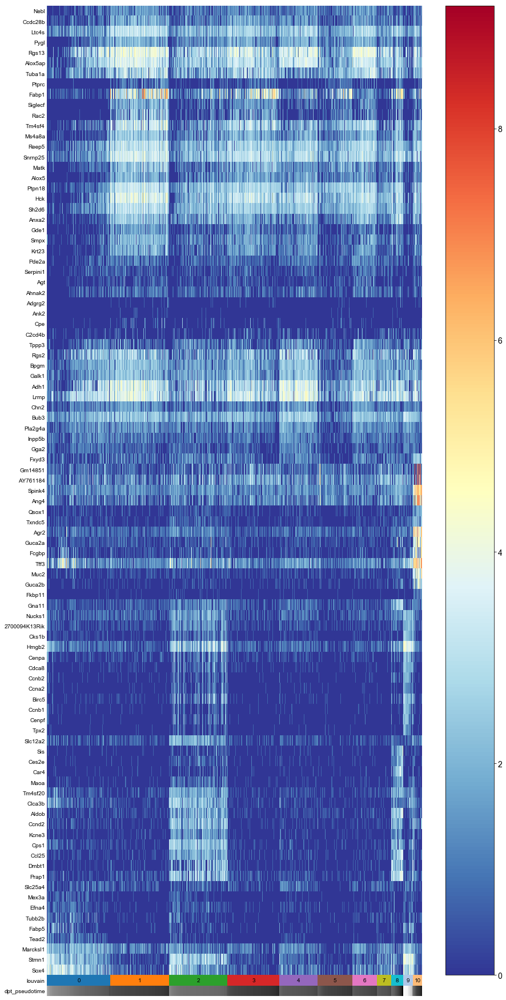

In [144]:
rcParams['figure.figsize']=(15,30)
sc.pl.paga_path(a_Tuft, keys=gene_names_diff, nodes=a_Tuft.obs['louvain'].cat.categories,color_map="RdYlBu_r")

### Rename groups and merge some

In [214]:
a_Tuft.obs['louvain'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], dtype='object')

In [145]:
a_Tuft.obs['Tuft_group_final']=a_Tuft.obs['louvain'].cat.add_categories(
    ['Tuft 2','Tuft 1', 'Tuft progenitor'])

#a_Tuft.obs['Tuft_group_final'][np.in1d(a_Tuft.obs['louvain'], ['1','8'])] = np.repeat(
#    'Lgr5 pos Tuft', np.in1d(a_Tuft.obs['louvain'], ['1', '8']).sum())
a_Tuft.obs['Tuft_group_final'][np.in1d(a_Tuft.obs['louvain'], ['0', '2', '8', '9'])] = np.repeat(
    'Tuft progenitor', np.in1d(a_Tuft.obs['louvain'], ['0', '2', '8', '9']).sum())
a_Tuft.obs['Tuft_group_final'][np.in1d(a_Tuft.obs['louvain'], ['4', '6', '7'])] = np.repeat(
    'Tuft 1', np.in1d(a_Tuft.obs['louvain'], ['4', '6', '7']).sum())
a_Tuft.obs['Tuft_group_final'][np.in1d(a_Tuft.obs['louvain'], ['1', '3', '5'])] = np.repeat(
    'Tuft 2', np.in1d(a_Tuft.obs['louvain'], ['1','3', '5']).sum())

a_Tuft.obs['Tuft_group_final']=a_Tuft.obs['Tuft_group_final'].cat.remove_unused_categories()

In [146]:
a_Tuft.obs['Tuft_group_final'].cat.categories

Index(['10', 'Tuft 2', 'Tuft 1', 'Tuft progenitor'], dtype='object')

Create a new (more coarse-grained) graph.

In [147]:
sc.tl.paga(a_Tuft, groups='Tuft_group_final')

running partition-based graph abstraction (PAGA)
    finished (0:00:00.07) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)


--> added 'pos', the PAGA positions (adata.uns['paga'])


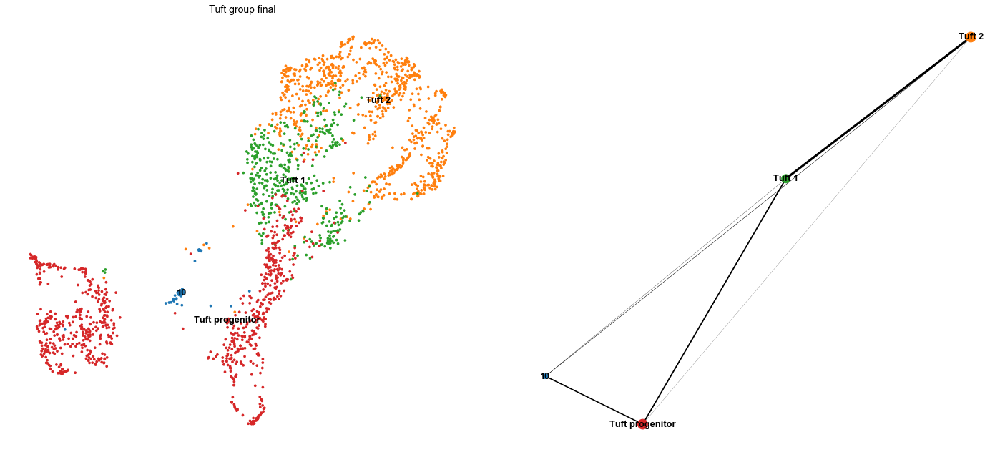

In [148]:
rcParams['figure.figsize']=(10,10)
sc.pl.paga_compare(a_Tuft,basis='umap', frameon=False)

Recompute gene ranking for the more coarse-grained clustering.

In [149]:
sc.tl.rank_genes_groups(a_Tuft, groupby='Tuft_group_final')

ranking genes
    finished (0:00:01.22) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids


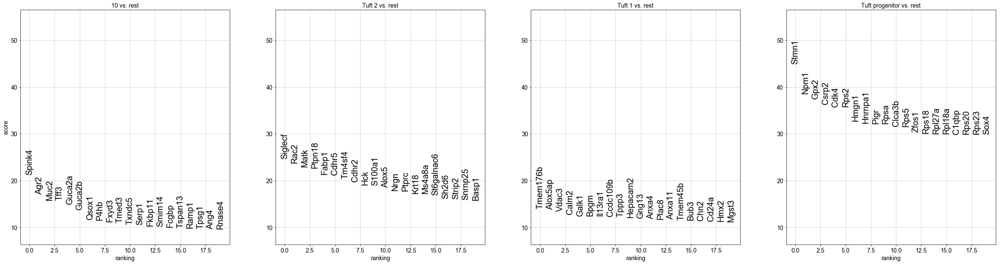

In [150]:
sc.pl.rank_genes_groups(a_Tuft, fontsize=20)

Collect the top 15 differential genes per cluster and paste them into a single variable (without duplicates). 

In [151]:
df = np.array([])
for i in a_Tuft.uns['rank_genes_groups']['names'].dtype.names:
    d = a_Tuft.uns['rank_genes_groups']['names'][i][:15]
    df = np.concatenate([df,d])

In [152]:
genes_tuft = pd.value_counts(df).index

In [153]:
genes_tuft

Index(['Matk', 'Tppp3', 'Zfos1', 'Ms4a8a', 'P4hb', 'Muc2', 'Hepacam2', 'Cdk4',
       'Rps5', 'Anxa4', 'Gng13', 'Tff3', 'Ptpn18', 'Galk1', 'Krt18', 'Stmn1',
       'Spink4', 'Tmem176b', 'Tmem45b', 'Npm1', 'Cdhr5', 'Cdhr2', 'Rpsa',
       'Rps18', 'Fxyd3', 'Guca2b', 'Agr2', 'Tm4sf4', 'Calm2', 'Qsox1',
       'Alox5ap', 'Il13ra1', 'Guca2a', 'Rpl27a', 'Fabp1', 'Txndc5', 'Alox5',
       'Smim14', 'Csrp2', 'Gpx2', 'Hck', 'Pigr', 'Bpgm', 'Fcgbp', 'Tmed3',
       'Vdac3', 'Fkbp11', 'Plac8', 'Hnrnpa1', 'Nrgn', 'Rps2', 'Rac2', 'Anxa11',
       'Ccdc109b', 'Ptprc', 'Hmgn1', 'Siglecf', 'S100a1', 'Clca3b', 'Serp1'],
      dtype='object')

In [154]:
genes_tuft_idx = np.flatnonzero(np.in1d(a_Tuft.var_names, genes_tuft))


Sort the differentially expressed genes by hierarchical clustering, *i.e.* by similar expression patterns. 

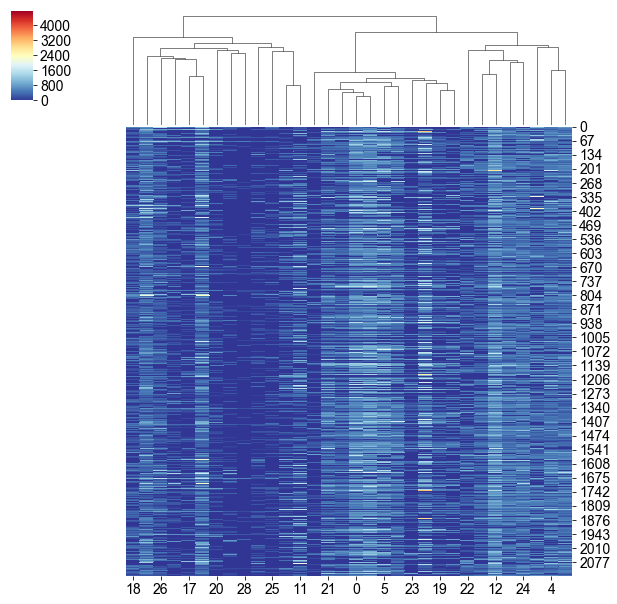

In [155]:
g=sns.clustermap(a_Tuft.X[:,genes_tuft_idx].todense(),cmap="RdYlBu_r",row_cluster=False,metric='correlation')

In [156]:
gene_names_diff=a_Tuft[:,genes_tuft_idx].var_names[g.dendrogram_col.reordered_ind]

Plot the final clustering.

In [157]:
a_Tuft.obs['Tuft_group_final'].cat.categories

Index(['10', 'Tuft 2', 'Tuft 1', 'Tuft progenitor'], dtype='object')

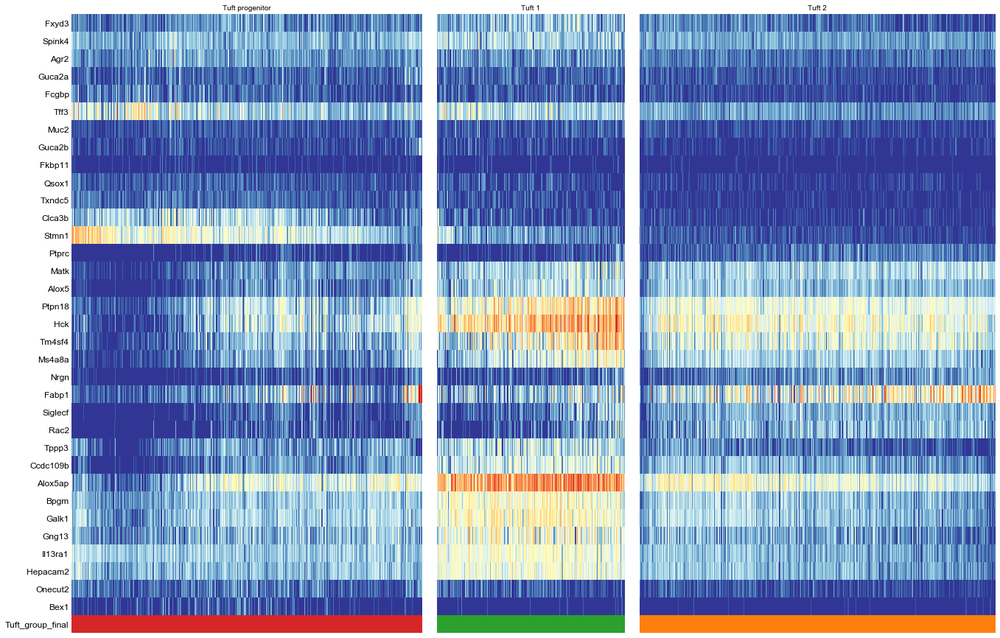

In [158]:
paths = [
         #('Lgr5 pos Tuft', ['Lgr5 pos Tuft']),
         ('Tuft progenitor', ['Tuft progenitor']), 
         ('Tuft 1', ['Tuft 1']),
         ('Tuft 2', ['Tuft 2'])
]

path_ratios= pd.value_counts(a_Tuft.obs['Tuft_group_final']).values
path_cat = pd.value_counts(a_Tuft.obs['Tuft_group_final']).index
tmp=np.zeros(len(paths))
for ipath, (descr, path) in enumerate(paths):
    #print(path[1])
    idx = np.flatnonzero(np.in1d(path_cat, path))
    #print(idx)
    tmp[ipath] = path_ratios[idx]
    
tmp = tmp.astype('int')
path_ratios = tmp / tmp.sum() *len(path_ratios)

_, axs = pl.subplots(ncols=len(tmp), figsize=(20, 15), 
                     gridspec_kw={'wspace': 0.05, 'left': 0.11,'width_ratios':path_ratios})
pl.subplots_adjust(left=0.05, right=0.98, top=0.88)
for ipath, (descr, path) in enumerate(paths):
    sc.pl.paga_path(a_Tuft, left_margin=0.3, ytick_fontsize=12, color_map='RdYlBu_r',
                   nodes=path, ax=axs[ipath],
                   keys=np.concatenate([gene_names_diff, ['Onecut2', 'Bex1']]),
                   annotations=[],
                   show_yticks=True if ipath==0 else False,
                   show_colorbar=False,                        
                   n_avg=2,
                   title='{}'.format(descr),
                   show_node_names=False,
                    
                   show=False)
#pl.savefig('./figures/aga_EEC.png', dpi=300)
pl.show()

Save annotation to file.

In [159]:
a_Tuft.obs['Tuft_group_final'].to_csv('./../data/Tuft_final_clustering_new.csv')

### Summary

We observe a Tuft progenitor population and two Tuft subtypes. Further, we identified putative doublets, which we exclude.

Merge subtype annotation into the full data set.

In [160]:
pd.crosstab(adata_ctrl.obs['refined_clustering'], adata_ctrl.obs['cell_type'])

cell_type,EEC,Enterocyte,Enterocyte progenitor,Goblet,ISC,Paneth,Tuft
refined_clustering,,,,,,,
EEC,2383,0,0,47,0,0,0
Enterocyte,0,5294,444,0,119,0,0
Enterocyte progenitor,0,259,5784,0,4662,0,0
Goblet cell,0,0,0,4335,0,0,0
Goblet progenitor,0,0,0,1512,0,0,0
ISC,0,2,341,0,8495,0,0
Paneth 1,0,0,0,0,0,14548,0
Paneth 2,0,0,0,0,0,923,0
Paneth primed ISC,0,6,891,0,825,0,0


In [161]:
adata_ctrl.obs['refined_clustering'] = pd.concat(
    [a_Tuft.obs['Tuft_group_final'], 
     adata_ctrl.obs['refined_clustering'][np.invert(np.in1d(adata_ctrl.obs['refined_clustering'],
                                                      ['Tuft']))]])

In [162]:
pd.value_counts(adata_ctrl.obs['refined_clustering'])

Paneth 1                     14548
Enterocyte progenitor        10705
ISC                           8838
Enterocyte                    5857
Goblet cell                   4335
EEC                           2430
Paneth primed ISC             1722
Goblet progenitor             1512
early Goblet                  1511
Paneth pro                    1325
Paneth 2                       923
Tuft 2                         832
Tuft progenitor                820
Sox4+ early EE progenitor      443
Tuft 1                         439
10                              52
Name: refined_clustering, dtype: int64

Remove the cells from cluster 8 (putative doublets).

In [163]:
adata_ctrl = adata_ctrl[adata_ctrl.obs['refined_clustering']!='10']

In [164]:
pd.value_counts(adata_ctrl.obs['refined_clustering'])

Paneth 1                     14548
Enterocyte progenitor        10705
ISC                           8838
Enterocyte                    5857
Goblet cell                   4335
EEC                           2430
Paneth primed ISC             1722
Goblet progenitor             1512
early Goblet                  1511
Paneth pro                    1325
Paneth 2                       923
Tuft 2                         832
Tuft progenitor                820
Sox4+ early EE progenitor      443
Tuft 1                         439
Name: refined_clustering, dtype: int64

## Save annotated data to file

In [165]:
adata_ctrl.write('./../data/gut_AB_AL_log_cor_control_anno.h5ad')